# Image Dataset Loading and Validation in Google Colab

As a first step, the image dataset must be uploaded into the Google Colab environment.
The entire images/ folder, containing all input test images, is transferred to Google Drive in order to ensure persistent access across Colab sessions.

Once the dataset is stored in Google Drive, the Drive is mounted inside the Colab runtime. This allows the images to be accessed using standard filesystem paths, exactly as in a local development environment.

To verify that the dataset has been correctly loaded and that the mounting process works as expected, a preliminary test is performed by reading and displaying a randomly selected image from the images/ folder. This step ensures that the input data is accessible before proceeding with the sequential and parallel (CUDA) implementations of the image processing algorithms.

---



# Choose images upload method

Set IMAGE_SOURCE to:
*   "upload" -> Uploading Images Directly into Google Colab
*   "drive" -> Loading Images from Google Drive



In [1]:
IMAGE_SOURCE = "drive"

In [2]:
from google.colab import drive

if IMAGE_SOURCE == "upload":
    IMAGES_DIR = "/content/images"
    OUTPUT_DIR = "/content/output"

elif IMAGE_SOURCE == "drive":
    drive.mount('/content/drive', force_remount=True)
    IMAGES_DIR = "/content/drive/MyDrive/ParallelDistributed/images"
    OUTPUT_DIR = "/content/drive/MyDrive/ParallelDistributed/output"

print("Images from:", IMAGES_DIR)
print("Output to:", OUTPUT_DIR)

Mounted at /content/drive
Images from: /content/drive/MyDrive/ParallelDistributed/images
Output to: /content/drive/MyDrive/ParallelDistributed/output


# Uploading Images Directly into Google Colab

In [ ]:
from google.colab import files
from PIL import Image
from IPython.display import display
import io
import os

if IMAGE_SOURCE == "upload":

  # Upload files from local machine
  uploaded = files.upload()

  print(f"\nUploaded {len(uploaded)} file(s)\n")

  # Output directory where images will be saved
  output_dir = "images"
  os.makedirs(output_dir, exist_ok=True)

  for filename, data in uploaded.items():
      try:
          # Open image from uploaded bytes
          image = Image.open(io.BytesIO(data))
          image = image.convert("RGB")

          # Ensure clean filename
          filename = os.path.basename(filename)
          save_path = os.path.join(output_dir, filename)

          # Save image inside images/
          image.save(save_path)

          # Remove original file from root directory
          if os.path.exists(filename):
              os.remove(filename)

          print(f"Moved and displayed: {filename}")
          display(image)

      except Exception as e:
          print(f"Skipping {filename} (not a valid image): {e}")

KeyboardInterrupt: 

# Loading Images from Google Drive


Reading images from: /content/drive/MyDrive/ParallelDistributed/images

Displaying: kodim15.png


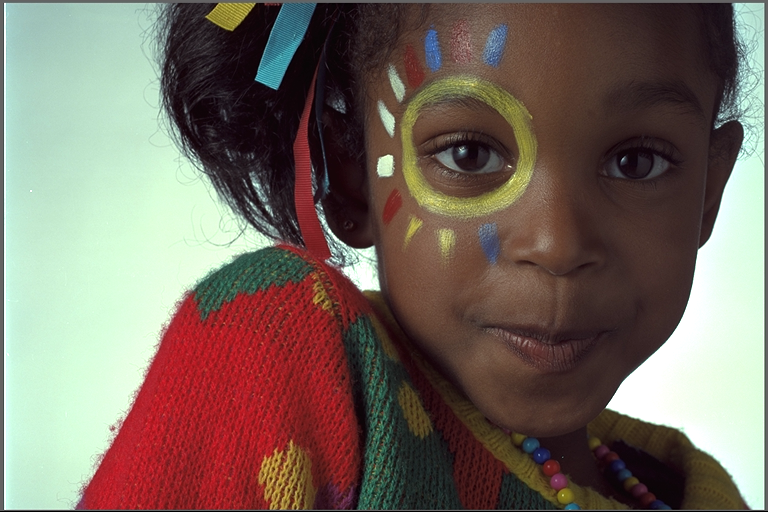

Displaying: kodim03.png


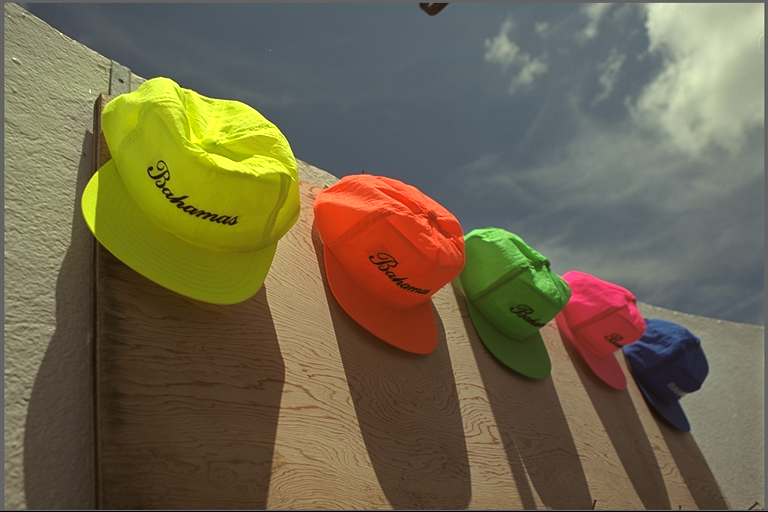

Displaying: kodim05.png


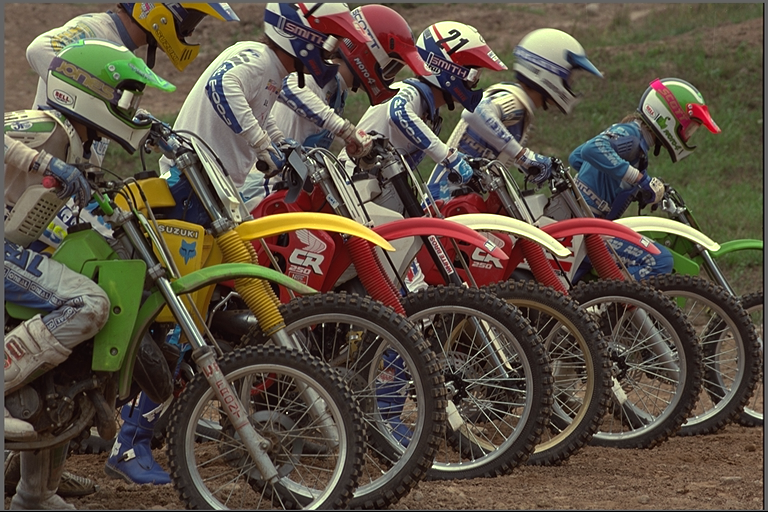

Displaying: kodim02.png


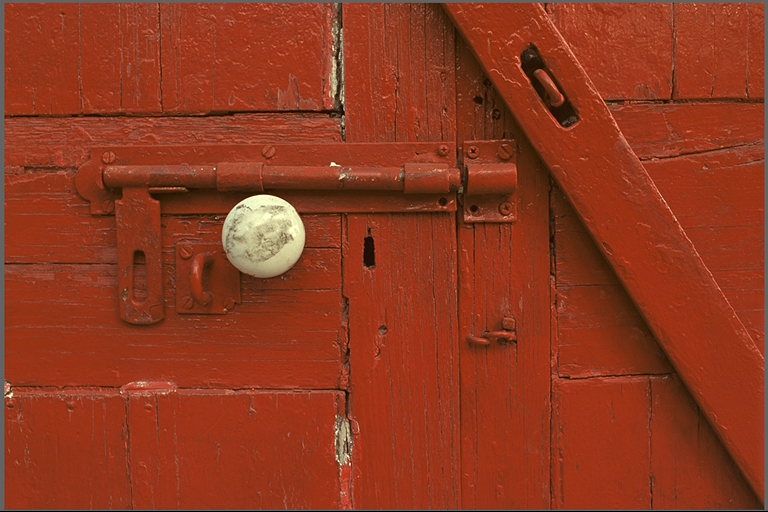

Displaying: kodim13.png


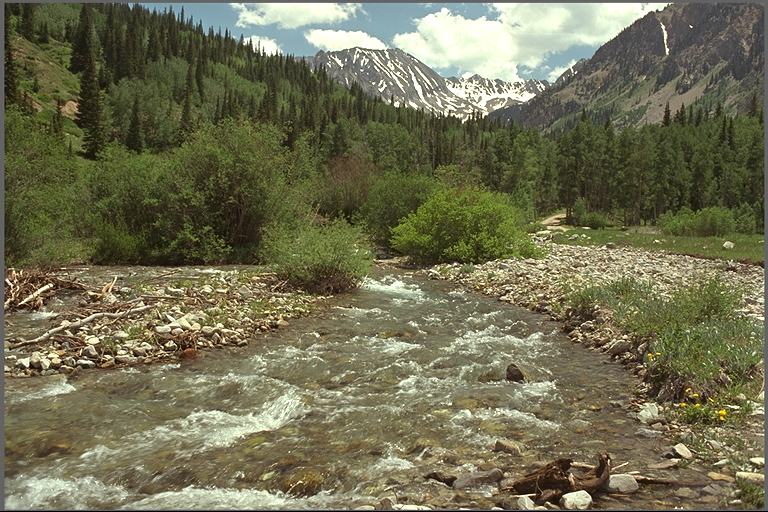

Displaying: kodim09.png


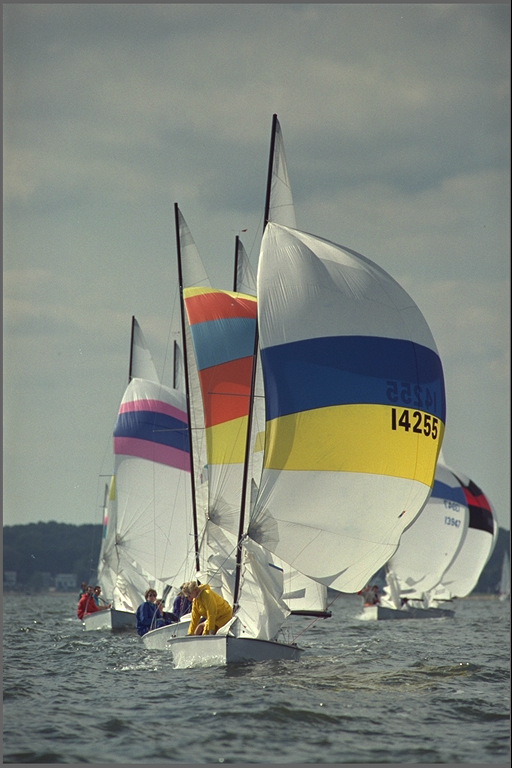

Displaying: kodim14.png


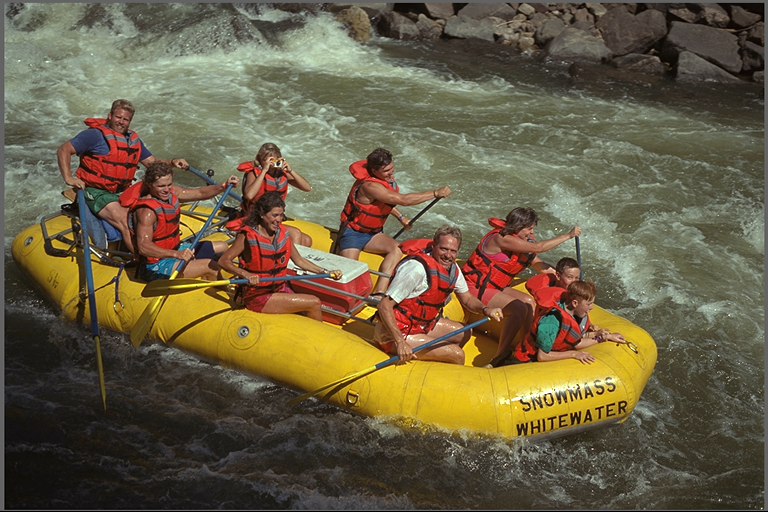

Displaying: kodim12.png


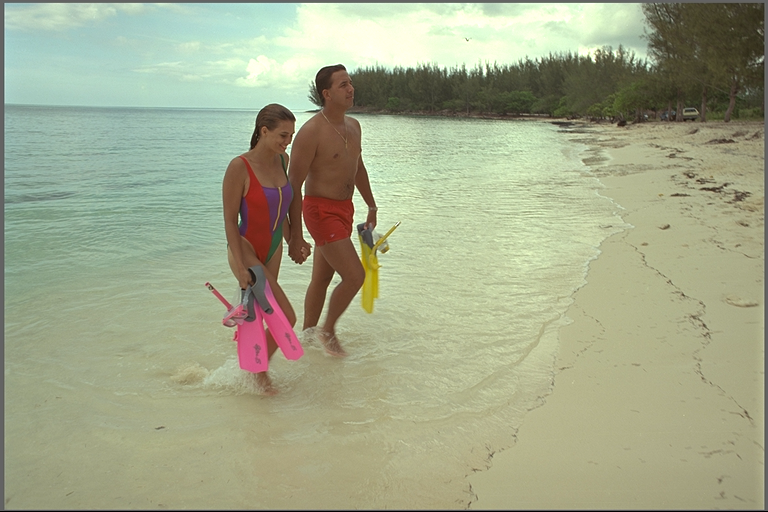

Displaying: kodim20.png


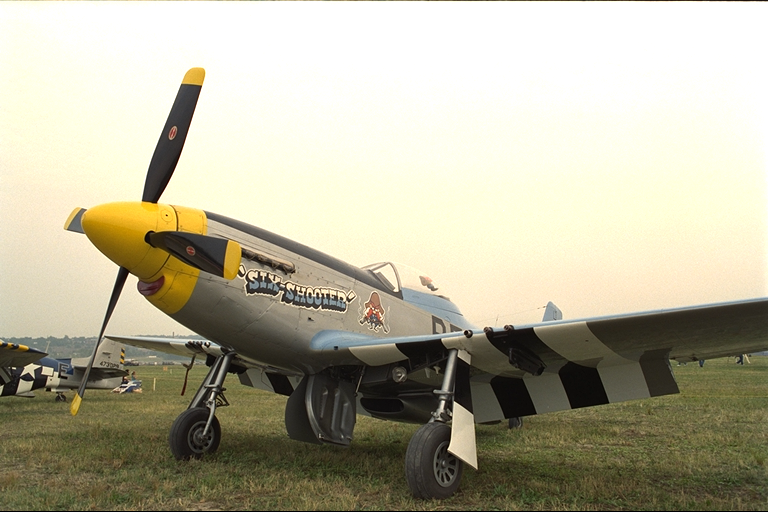

Displaying: kodim24.png


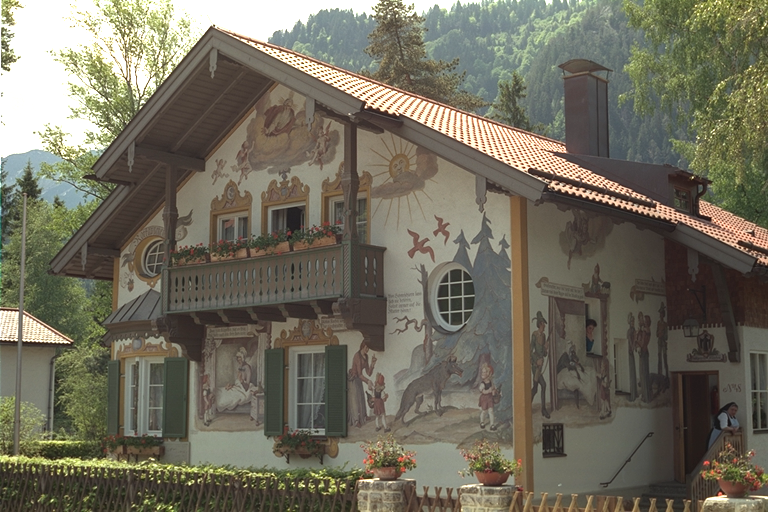

Displaying: kodim18.png


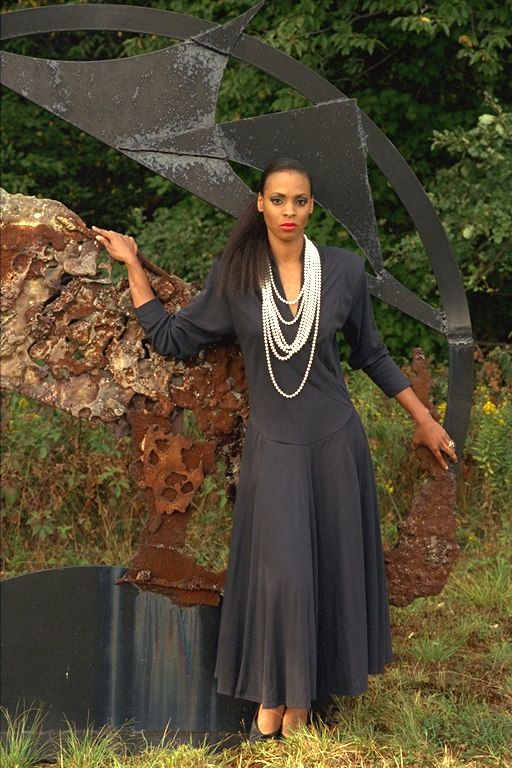

Displaying: kodim22.png


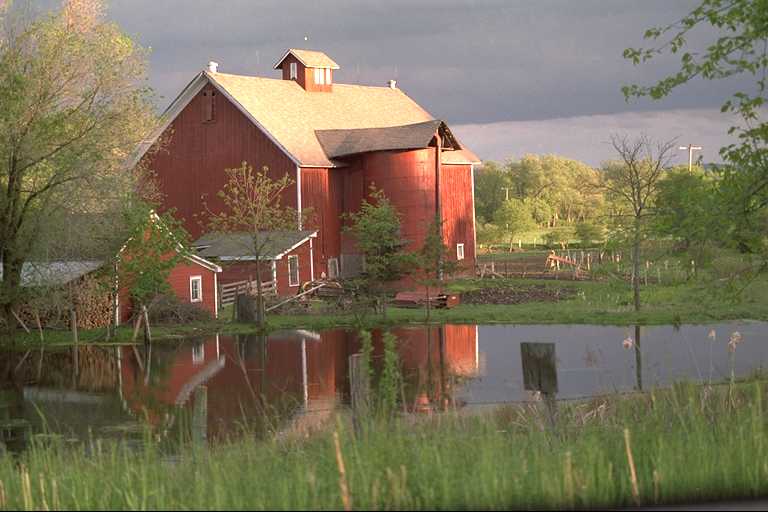

Displaying: kodim01.png


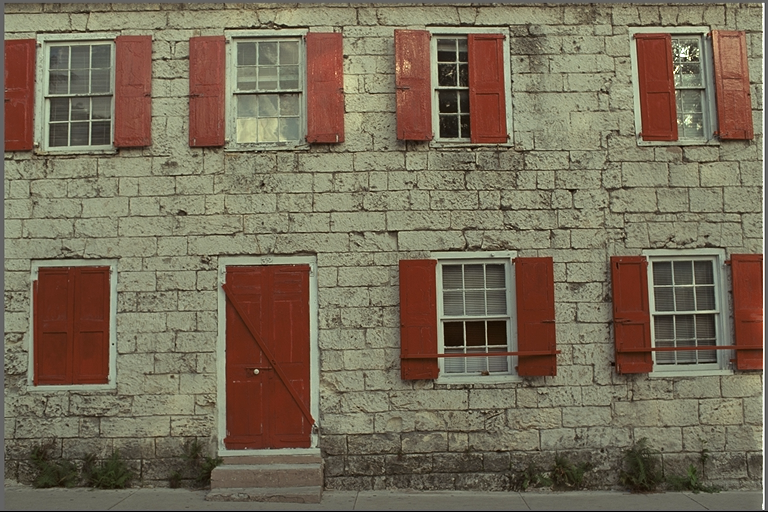

Displaying: kodim11.png


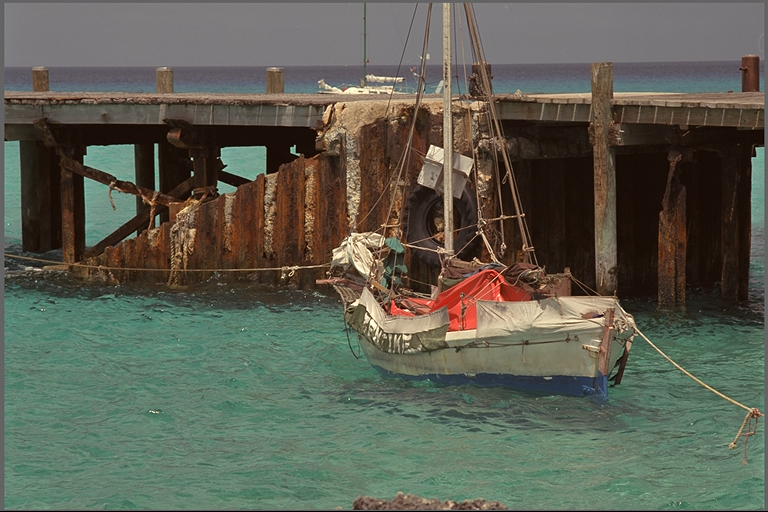

Displaying: kodim21.png


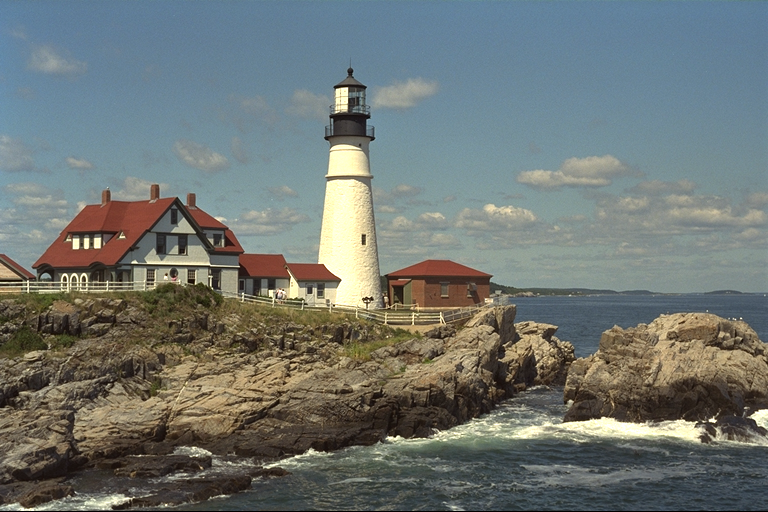

Displaying: kodim16.png


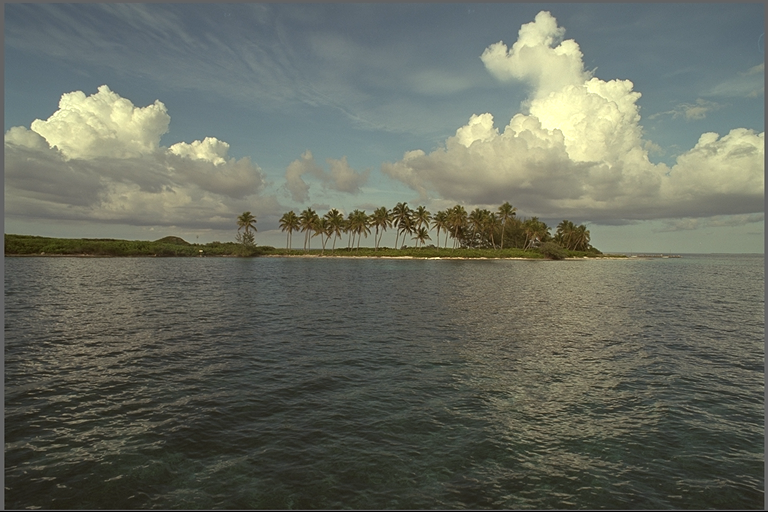

Displaying: kodim17.png


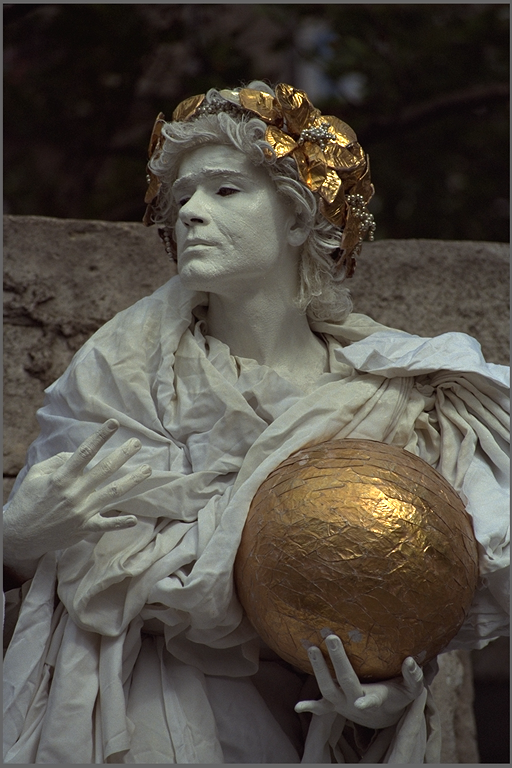

Displaying: kodim07.png


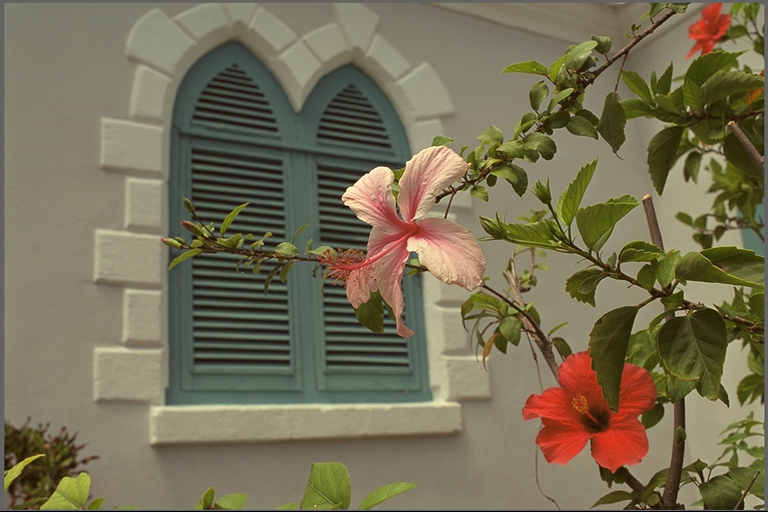

Displaying: kodim19.png


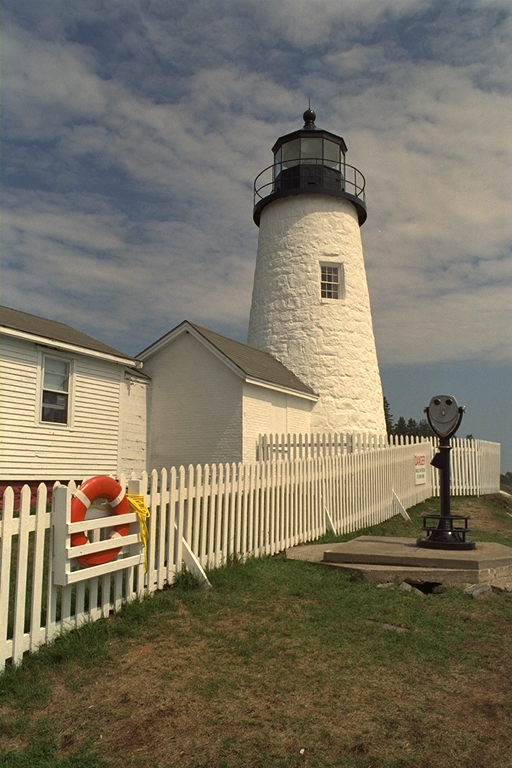

Displaying: kodim08.png


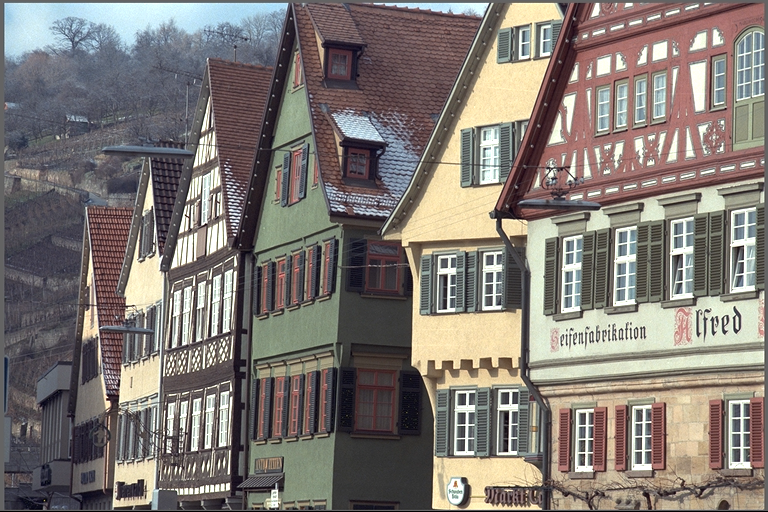

Displaying: kodim23.png


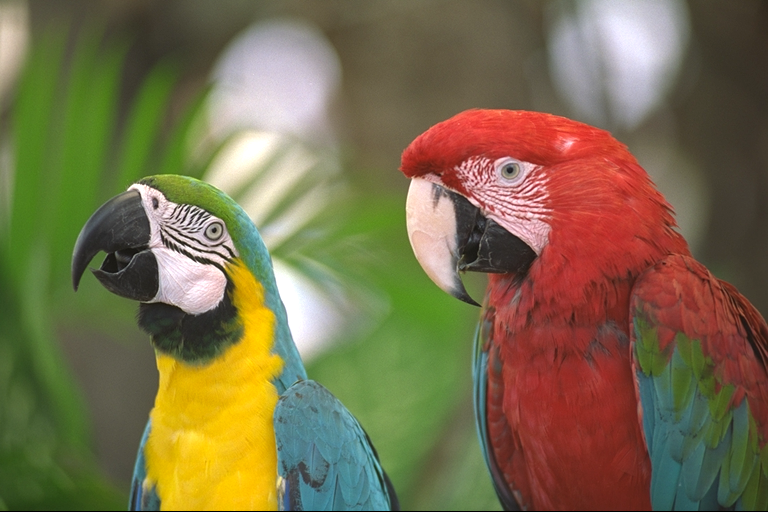

Displaying: kodim06.png


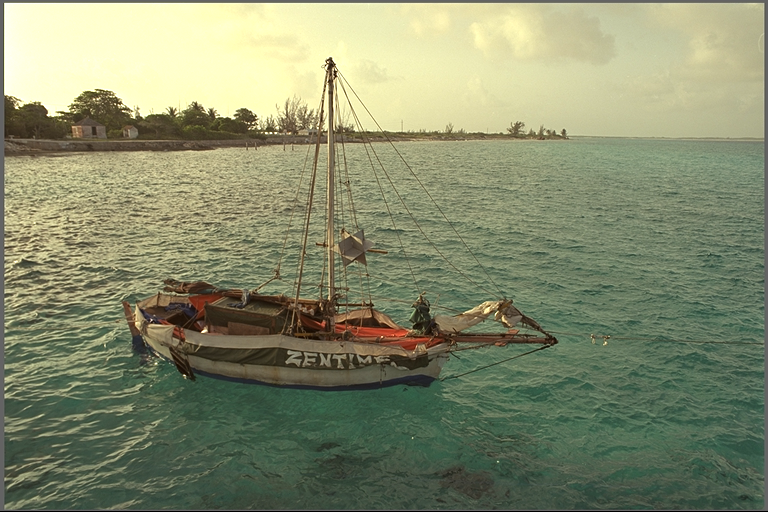

Displaying: kodim10.png


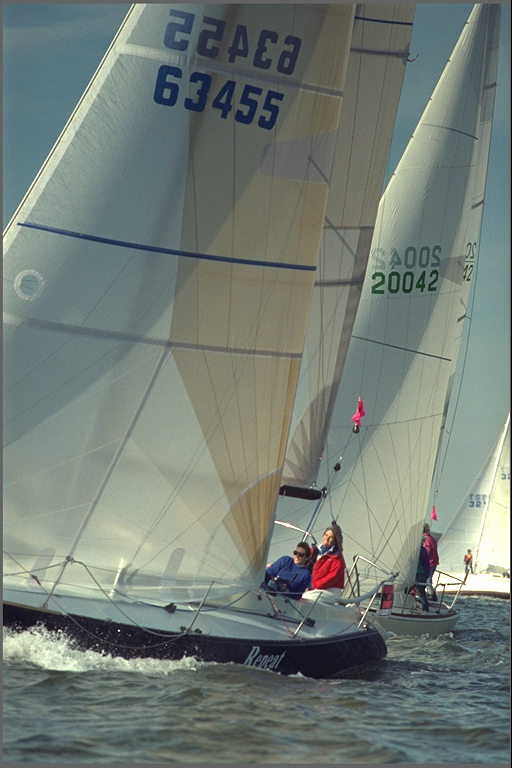

Displaying: kodim04.png


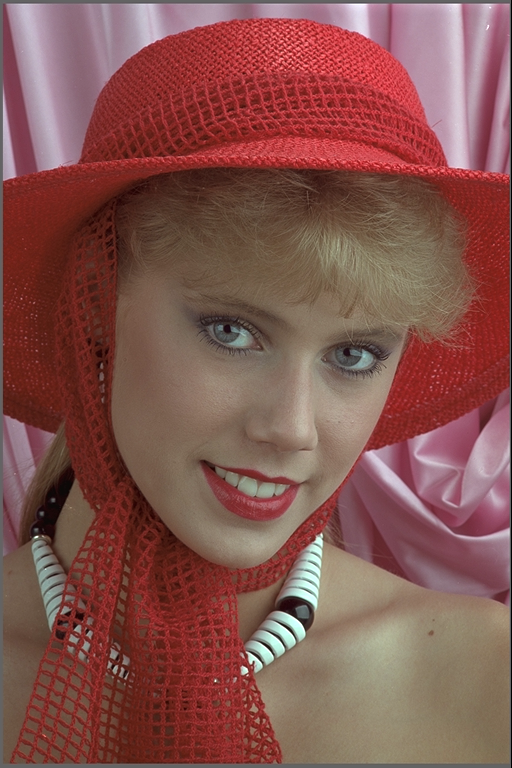

In [29]:
import os
from PIL import Image
if IMAGE_SOURCE == "drive":

  # Path to the images folder in Drive
  images_path = IMAGES_DIR

  print(f"\nReading images from: {images_path}\n")

  for filename in os.listdir(images_path):
      file_path = os.path.join(images_path, filename)

      try:
          image = Image.open(file_path)
          image = image.convert("RGB")

          print(f"Displaying: {filename}")
          display(image)

      except Exception as e:
          print(f"Skipping {filename}: {e}")

# Libs

In [3]:
!wget -q https://raw.githubusercontent.com/nothings/stb/master/stb_image.h
!wget -q https://raw.githubusercontent.com/nothings/stb/master/stb_image_write.h

In [4]:
!apt update
!apt install -y libopencv-dev

Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:2 https://cli.github.com/packages stable InRelease [3,917 B]
Get:3 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:4 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:5 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [2,361 kB]
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Hit:7 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:8 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ Packages [85.0 kB]
Get:9 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:10 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [9,729 kB]
Hit:11 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Get:12 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,298 kB]
Hit:13 https://ppa.launchpadcontent.net/grap

In [ ]:
!pkg-config --modversion opencv4

4.5.4


# OpenCV implementation (only for test)

In [ ]:
%%writefile main_test_image_processing.cpp

#include <opencv2/core.hpp>
#include <opencv2/imgcodecs.hpp>
#include <opencv2/imgproc.hpp>

#include <optional>
#include <filesystem>
#include <chrono>
#include <cctype>
#include <iomanip>
#include <iostream>
#include <random>
#include <stdexcept>
#include <string>
#include <vector>

namespace fs = std::filesystem;

// ================= IMAGE SELECTION =================
// If set → use this image
// If std::nullopt → pick a random image
// std::optional<fs::path> selected_image =
//     std::nullopt;
// Example:
std::optional<fs::path> selected_image =
    "/content/drive/MyDrive/ParallelDistributed/images/kodim01.png";
// ===================================================

struct Timer {
    explicit Timer(const std::string &label)
        : label_(label),
          start_(std::chrono::high_resolution_clock::now()) {}

    ~Timer() {
        auto end = std::chrono::high_resolution_clock::now();
        auto ms =
            std::chrono::duration_cast<std::chrono::microseconds>(end - start_).count() / 1000.0;

        std::cout << std::fixed << std::setprecision(3)
                  << label_ << ": " << ms << " ms\n";
    }

private:
    std::string label_;
    std::chrono::high_resolution_clock::time_point start_;
};

std::vector<fs::path> list_images(const fs::path &dir) {
    if (!fs::exists(dir) || !fs::is_directory(dir)) {
        throw std::runtime_error("Images directory not found: " + dir.string());
    }

    std::vector<fs::path> images;
    for (const auto &entry : fs::directory_iterator(dir)) {
        if (!entry.is_regular_file()) continue;

        std::string ext = entry.path().extension().string();
        for (char &c : ext) c = static_cast<char>(std::tolower(static_cast<unsigned char>(c)));

        if (ext == ".png" || ext == ".jpg" || ext == ".jpeg") {
            images.push_back(entry.path());
        }
    }

    if (images.empty()) {
        throw std::runtime_error("No images found in: " + dir.string());
    }

    return images;
}

// ------------------- RGB -> YUV  -------------------
cv::Mat rgb_to_yuv(const cv::Mat &rgb) {
    cv::Mat yuv;
    cv::cvtColor(rgb, yuv, cv::COLOR_RGB2YUV);
    return yuv;
}

// ---------------- RGB -> Grayscale ----------------
static std::vector<uint8_t> rgb_to_gray_u8(const uint8_t* rgb, int w, int h, int channels) {
    std::vector<uint8_t> gray(w * h);
    for (int i = 0; i < w * h; ++i) {
        int idx = i * channels;
        uint8_t r = rgb[idx + 0];
        uint8_t g = (channels > 1) ? rgb[idx + 1] : r;
        uint8_t b = (channels > 2) ? rgb[idx + 2] : r;
        int y = int(0.299f * r + 0.587f * g + 0.114f * b);
        gray[i] = static_cast<uint8_t>(std::clamp(y, 0, 255));
    }
    return gray;
}

// ---------------- Gaussian blur 2D ----------------
cv::Mat gaussian_blur_2d(const cv::Mat &input, int kernel_size, double sigma) {
    cv::Mat output;
    cv::GaussianBlur(input, output, cv::Size(kernel_size, kernel_size), sigma, sigma, cv::BORDER_DEFAULT);
    return output;
}

// ---------------- Gaussian blur separable ----------------
cv::Mat gaussian_blur_separable(const cv::Mat &input, int kernel_size, double sigma) {
    cv::Mat output;
    cv::GaussianBlur(input, output, cv::Size(kernel_size, kernel_size), sigma, sigma, cv::BORDER_DEFAULT);
    return output;
}

// ---------------- Sobel edge detection ----------------
cv::Mat sobel_edge(const cv::Mat &gray) {
    cv::Mat grad_x, grad_y;
    cv::Sobel(gray, grad_x, CV_32F, 1, 0, 3);
    cv::Sobel(gray, grad_y, CV_32F, 0, 1, 3);
    cv::Mat mag;
    cv::magnitude(grad_x, grad_y, mag);
    cv::normalize(mag, mag, 0, 255, cv::NORM_MINMAX);
    cv::Mat out;
    mag.convertTo(out, CV_8U);
    return out;
}

int main(int argc, char **argv) {
    try {
        fs::path images_dir = "/content/drive/MyDrive/ParallelDistributed/images";
        fs::path output_dir = "/content/drive/MyDrive/ParallelDistributed/output";

        if (argc > 1) images_dir = fs::path(argv[1]);
        if (argc > 2) output_dir = fs::path(argv[2]);

        auto images = list_images(images_dir);

        fs::path selected;
        if (selected_image.has_value()) {
            selected = *selected_image;
            if (!fs::exists(selected)) throw std::runtime_error("Selected image not found: " + selected.string());
        } else {
            std::mt19937 rng(static_cast<unsigned int>(
                std::chrono::high_resolution_clock::now().time_since_epoch().count()));
            std::uniform_int_distribution<size_t> dist(0, images.size() - 1);
            selected = images[dist(rng)];
        }

        std::cout << "Selected image: " << selected.string() << "\n";

        // ---------------- Load image ----------------
        cv::Mat bgr = cv::imread(selected.string(), cv::IMREAD_COLOR);
        if (bgr.empty()) throw std::runtime_error("Failed to load image: " + selected.string());

        // ---------------- RGB conversion ----------------
        cv::Mat rgb;
        cv::cvtColor(bgr, rgb, cv::COLOR_BGR2RGB);

        fs::create_directories(output_dir);

        // ---------------- RGB -> YUV (rimane intatto) ----------------
        cv::Mat yuv;
        {
            Timer t("RGB -> YUV");
            yuv = rgb_to_yuv(rgb);
        }

        // ---------------- Split YUV channels ----------------
        std::vector<cv::Mat> yuv_channels;
        cv::split(yuv, yuv_channels);

        cv::Mat Y = yuv_channels[0];
        cv::Mat U = yuv_channels[1];
        cv::Mat V = yuv_channels[2];

        // ---------------- RGB -> Grayscale per processing ----------------
        std::vector<uint8_t> gray_vec = rgb_to_gray_u8(rgb.data, rgb.cols, rgb.rows, rgb.channels());
        cv::Mat gray(rgb.rows, rgb.cols, CV_8U, gray_vec.data());

        // ---------------- Gaussian Blur 2D ----------------
        cv::Mat blur2d;
        {
            Timer t("Gaussian Blur 2D");
            blur2d = gaussian_blur_2d(gray, 7, 1.5);
        }

        // ---------------- Gaussian Blur Separable ----------------
        cv::Mat blur_sep;
        {
            Timer t("Gaussian Blur Separable");
            blur_sep = gaussian_blur_separable(gray, 7, 1.5);
        }

        // ---------------- Sobel Edge Detection ----------------
        cv::Mat edges;
        {
            Timer t("Sobel Edge Detection");
            edges = sobel_edge(gray);
        }

        // ---------------- Save outputs ----------------
        cv::Mat blur2d_bgr, blur_sep_bgr, yuv_bgr;
        cv::cvtColor(blur2d, blur2d_bgr, cv::COLOR_GRAY2BGR);
        cv::cvtColor(blur_sep, blur_sep_bgr, cv::COLOR_GRAY2BGR);
        cv::cvtColor(yuv, yuv_bgr, cv::COLOR_RGB2BGR);

        cv::imwrite((output_dir / "opencv_yuv.png").string(), yuv_bgr);
        cv::imwrite((output_dir / "opencv_gaussian_2d.png").string(), blur2d_bgr);
        cv::imwrite((output_dir / "opencv_gaussian_separable.png").string(), blur_sep_bgr);
        cv::imwrite((output_dir / "opencv_sobel_edges.png").string(), edges);

        // ---------------- Save separated YUV channels ----------------
        cv::imwrite((output_dir / "opencv_Y.png").string(), Y);
        cv::imwrite((output_dir / "opencv_U.png").string(), U);
        cv::imwrite((output_dir / "opencv_V.png").string(), V);

        std::cout << "Saved outputs to: " << output_dir.string() << "\n";
        return 0;

    } catch (const std::exception &ex) {
        std::cerr << "Error: " << ex.what() << "\n";
        return 1;
    }
}


Writing main_test_image_processing.cpp


In [ ]:
!g++ main_test_image_processing.cpp -o main_test_image_processing `pkg-config --cflags --libs opencv4` && ./main_test_image_processing

Selected image: /content/drive/MyDrive/ParallelDistributed/images/kodim01.png
RGB -> YUV: 0.670 ms
Gaussian Blur 2D: 0.687 ms
Gaussian Blur Separable: 0.541 ms
Sobel Edge Detection: 3.583 ms
Saved outputs to: /content/drive/MyDrive/ParallelDistributed/output


# Sobel Edge Detection

## CPU

In [16]:
%%writefile sobel_edge_detection_cpu.cpp

#include <cstdint>
#include <iostream>
#include <string>
#include <vector>
#include <algorithm>
#include <filesystem>
#include <cmath>
#include <chrono>
#include <cctype>
#include <iomanip>
#include <random>
#include <stdexcept>
#include <optional>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"

#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

// -------------------------------------------------------------------------
// Helper function: list all images in a directory
// -------------------------------------------------------------------------
std::vector<fs::path> list_images(const fs::path &dir) {
    if (!fs::exists(dir) || !fs::is_directory(dir)) {
        throw std::runtime_error("Images directory not found: " + dir.string());
    }

    std::vector<fs::path> images;
    for (const auto &entry : fs::directory_iterator(dir)) {
        if (!entry.is_regular_file()) continue;
        std::string ext = entry.path().extension().string();
        for (char &c : ext) c = static_cast<char>(std::tolower(static_cast<unsigned char>(c)));
        if (ext == ".png" || ext == ".jpg" || ext == ".jpeg") images.push_back(entry.path());
    }
    if (images.empty()) throw std::runtime_error("No images found in: " + dir.string());
    return images;
}

// -------------------------------------------------------------------------
// Convert RGB image to grayscale
// -------------------------------------------------------------------------
static std::vector<uint8_t> rgb_to_gray_u8(const uint8_t* rgb, int w, int h, int channels) {
    std::vector<uint8_t> gray(w * h);
    for (int i = 0; i < w * h; ++i) {
        int idx = i * channels;
        uint8_t r = rgb[idx + 0];
        uint8_t g = (channels > 1) ? rgb[idx + 1] : r;
        uint8_t b = (channels > 2) ? rgb[idx + 2] : r;
        int y = int(0.299f * r + 0.587f * g + 0.114f * b);
        gray[i] = static_cast<uint8_t>(std::clamp(y, 0, 255));
    }
    return gray;
}

// -------------------------------------------------------------------------
// Sobel edge detection on CPU
// -------------------------------------------------------------------------
static std::vector<uint8_t> sobel_edge_cpu(const uint8_t* gray, int width, int height) {
    auto at = [&](int x, int y) -> uint8_t {
        x = std::clamp(x, 0, width - 1);
        y = std::clamp(y, 0, height - 1);
        return gray[y * width + x];
    };

    std::vector<uint8_t> out(width * height, 0);

    for (int y = 0; y < height; ++y) {
        for (int x = 0; x < width; ++x) {
            int gx =
                -1 * at(x - 1, y - 1) + 1 * at(x + 1, y - 1) +
                -2 * at(x - 1, y    ) + 2 * at(x + 1, y    ) +
                -1 * at(x - 1, y + 1) + 1 * at(x + 1, y + 1);

            int gy =
                 1 * at(x - 1, y - 1) + 2 * at(x,     y - 1) + 1 * at(x + 1, y - 1) +
                -1 * at(x - 1, y + 1) - 2 * at(x,     y + 1) - 1 * at(x + 1, y + 1);

            float mag = std::sqrt(float(gx * gx + gy * gy));
            int v = (mag > 255.0f) ? 255 : int(mag);
            out[y * width + x] = static_cast<uint8_t>(v);
        }
    }
    return out;
}

int main(int argc, char** argv) {

    // -------------------------------------------------------------------------
    // Setup paths: use CLI arguments if provided, otherwise default paths
    // -------------------------------------------------------------------------
    fs::path input_path;
    fs::path output_dir;


    if (argc >= 2) {
        input_path = fs::path(argv[1]);
    } else {
        input_path = "/content/images";   // default (directory)
    }

    if (argc >= 3) {
        output_dir = fs::path(argv[2]);
    } else {
        output_dir = "/content/output";
    }

    fs::path selected;

    // Caso 1: argv[1] è un file esistente
    if (fs::exists(input_path) && fs::is_regular_file(input_path)) {
        selected = input_path;
    }
    // Caso 2: argv[1] è una directory
    else if (fs::exists(input_path) && fs::is_directory(input_path)) {
        fs::path candidate = input_path / "kodim01.png";
        if (fs::exists(candidate)) {
            selected = candidate;
        } else {
            auto all_images = list_images(input_path);
            selected = all_images[0];
        }
    }
    else {
        std::cerr << "Invalid input path (not a file or directory): " << input_path << std::endl;
        return 1;
    }

    std::cout << "Selected image: " << selected.string() << std::endl;

    int w = 0, h = 0, ch = 0;
    uint8_t* img = stbi_load(selected.c_str(), &w, &h, &ch, 3);
    if (!img) {
        std::cerr << "Failed to load image: " << selected << std::endl;
        return 1;
    }

    auto gray = rgb_to_gray_u8(img, w, h, 3);
    stbi_image_free(img);

    // -------------------------------------------------------------------------
    // Benchmarking: 10 iterations for CPU average
    // -------------------------------------------------------------------------
    const int iterations = 10;
    std::cout << "Starting CPU Benchmarking (" << iterations << " iterations)..." << std::endl;

    auto t0 = std::chrono::high_resolution_clock::now();
    for(int i = 0; i < iterations; ++i) {
        auto edges = sobel_edge_cpu(gray.data(), w, h);
    }
    auto t1 = std::chrono::high_resolution_clock::now();

    // Final execution for output save
    auto edges = sobel_edge_cpu(gray.data(), w, h);

    // -------------------------------------------------------------------------
    // Timing and metrics calculations
    // -------------------------------------------------------------------------
    double total_ms = std::chrono::duration<double, std::milli>(t1 - t0).count();
    double avg_cpu_ms = total_ms / (double)iterations;
    size_t img_size = (size_t)w * h;

    double total_bytes = (double)img_size * 2.0; // 1 read + 1 write
    double bandwidth_gbs = (total_bytes / (avg_cpu_ms * 1e-3)) / 1e9;
    double throughput_mpx = ((double)img_size / (avg_cpu_ms * 1e-3)) / 1e6;
    double speedup = 1.0; // baseline itself

    std::cout << std::fixed << std::setprecision(4);
    std::cout << "--- Sobel CPU Performance Report ---" << std::endl;
    std::cout << "Resolution: " << w << "x" << h << " (" << (double)img_size/1e6 << " MPixels)" << std::endl;
    std::cout << "Avg Execution Time: " << avg_cpu_ms << " ms" << std::endl;
    std::cout << "Throughput: " << throughput_mpx << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << bandwidth_gbs << " GB/s" << std::endl;
    std::cout << "--- PCIe Overhead Analysis ---" << std::endl;
    std::cout << "Host to Device (H2D): 0.0000 ms (Native CPU)" << std::endl;
    std::cout << "Device to Host (D2H): 0.0000 ms (Native CPU)" << std::endl;
    std::cout << "--- Speedup Analysis ---" << std::endl;
    std::cout << "Speedup vs CPU: " << speedup << "x (Baseline)" << std::endl;

    // -------------------------------------------------------------------------
    // Save output
    // -------------------------------------------------------------------------
    fs::create_directories(output_dir);
    fs::path output_path = output_dir / "sobel_cpu.png";
    stbi_write_png(output_path.string().c_str(), w, h, 1, edges.data(), w);

    return 0;
}

Writing sobel_edge_detection_cpu.cpp


In [ ]:
!g++ sobel_edge_detection_cpu.cpp -o sobel_edge_detection_cpu && ./sobel_edge_detection_cpu {IMAGES_DIR} {OUTPUT_DIR}

Selected image: /content/drive/MyDrive/ParallelDistributed/images/kodim01.png
Starting CPU Benchmarking (10 iterations)...
--- Sobel CPU Performance Report ---
Resolution: 768x512 (0.3932 MPixels)
Avg Execution Time: 58.5592 ms
Throughput: 6.7148 MPixels/s
Effective Bandwidth: 0.0134 GB/s
--- PCIe Overhead Analysis ---
Host to Device (H2D): 0.0000 ms (Native CPU)
Device to Host (D2H): 0.0000 ms (Native CPU)
--- Speedup Analysis ---
Speedup vs CPU: 1.0000x (Baseline)


## CPU FAST

In [17]:
%%writefile sobel_edge_detection_cpu_fast.cpp
#include <cstdint>
#include <iostream>
#include <string>
#include <vector>
#include <algorithm>
#include <filesystem>
#include <cmath>
#include <chrono>
#include <cctype>
#include <iomanip>
#include <random>
#include <stdexcept>
#include <optional>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"
#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

// -------------------------------------------------------------------------
// Helper function: list all images in a directory
// -------------------------------------------------------------------------
std::vector<fs::path> list_images(const fs::path &dir) {
    if (!fs::exists(dir) || !fs::is_directory(dir)) {
        throw std::runtime_error("Images directory not found: " + dir.string());
    }
    std::vector<fs::path> images;
    for (const auto &entry : fs::directory_iterator(dir)) {
        if (!entry.is_regular_file()) continue;
        std::string ext = entry.path().extension().string();
        for (char &c : ext) c = static_cast<char>(std::tolower(static_cast<unsigned char>(c)));
        if (ext == ".png" || ext == ".jpg" || ext == ".jpeg") images.push_back(entry.path());
    }
    return images;
}

// -------------------------------------------------------------------------
// Convert RGB image to grayscale (fast approximation)
// -------------------------------------------------------------------------
static std::vector<uint8_t> rgb_to_gray_u8_fast(const uint8_t* rgb, int w, int h) {
    std::vector<uint8_t> gray((size_t)w * h);
    for (int i = 0; i < w * h; ++i) {
        int idx = i * 3;
        int r = rgb[idx + 0];
        int g = rgb[idx + 1];
        int b = rgb[idx + 2];
        gray[i] = (uint8_t)((77 * r + 150 * g + 29 * b) >> 8);
    }
    return gray;
}

// -------------------------------------------------------------------------
// Sobel edge detection on CPU (fast)
// -------------------------------------------------------------------------
static std::vector<uint8_t> sobel_edge_cpu_fast(const uint8_t* gray, int w, int h) {
    std::vector<uint8_t> out((size_t)w * h, 0);
    if (w < 3 || h < 3) return out;

    for (int y = 1; y < h - 1; ++y) {
        const uint8_t* row0 = gray + (size_t)(y - 1) * w;
        const uint8_t* row1 = gray + (size_t)(y    ) * w;
        const uint8_t* row2 = gray + (size_t)(y + 1) * w;
        uint8_t* dst = out.data() + (size_t)y * w;

        for (int x = 1; x < w - 1; ++x) {
            int p00 = row0[x - 1], p01 = row0[x], p02 = row0[x + 1];
            int p10 = row1[x - 1],             p12 = row1[x + 1];
            int p20 = row2[x - 1], p21 = row2[x], p22 = row2[x + 1];

            int gx = (p02 + 2 * p12 + p22) - (p00 + 2 * p10 + p20);
            int gy = (p00 + 2 * p01 + p02) - (p20 + 2 * p21 + p22);

            float mag = std::sqrt(float(gx * gx + gy * gy));
            int v = (int)mag;
            if (v > 255) v = 255;
            dst[x] = (uint8_t)v;
        }
    }
    return out;
}

int main(int argc, char** argv) {

    // -------------------------------------------------------------------------
    // Setup paths: use CLI arguments if provided, otherwise default paths
    // -------------------------------------------------------------------------
    fs::path input_path;
    fs::path output_dir;
    double cpu_standard_ms = 150.0; // Placeholder for speedup calculation

    if (argc >= 2) {
        input_path = fs::path(argv[1]);
    } else {
        input_path = "/content/images";   // default (directory)
    }

    if (argc >= 3) {
        output_dir = fs::path(argv[2]);
    } else {
        output_dir = "/content/output";
    }

    fs::path selected;

    // Caso 1: argv[1] è un file esistente
    if (fs::exists(input_path) && fs::is_regular_file(input_path)) {
        selected = input_path;
    }
    // Caso 2: argv[1] è una directory
    else if (fs::exists(input_path) && fs::is_directory(input_path)) {
        fs::path candidate = input_path / "kodim01.png";
        if (fs::exists(candidate)) {
            selected = candidate;
        } else {
            auto all_images = list_images(input_path);
            selected = all_images[0];
        }
    }
    else {
        std::cerr << "Invalid input path (not a file or directory): " << input_path << std::endl;
        return 1;
    }

    std::cout << "Selected image: " << selected.string() << std::endl;

    int w = 0, h = 0, ch = 0;
    uint8_t* img = stbi_load(selected.c_str(), &w, &h, &ch, 3);
    if (!img) {
        std::cerr << "Failed to load image: " << selected << std::endl;
        return 1;
    }

    auto gray = rgb_to_gray_u8_fast(img, w, h);
    stbi_image_free(img);

    // -------------------------------------------------------------------------
    // Benchmarking: 10 iterations for CPU average
    // -------------------------------------------------------------------------
    const int iterations = 10;
    std::cout << "Starting CPU FAST Benchmarking (" << iterations << " iterations)..." << std::endl;

    auto t0 = std::chrono::high_resolution_clock::now();
    for(int i = 0; i < iterations; ++i) {
        auto edges = sobel_edge_cpu_fast(gray.data(), w, h);
    }
    auto t1 = std::chrono::high_resolution_clock::now();

    auto edges = sobel_edge_cpu_fast(gray.data(), w, h);

    // -------------------------------------------------------------------------
    // Performance math
    // -------------------------------------------------------------------------
    double total_ms = std::chrono::duration<double, std::milli>(t1 - t0).count();
    double avg_cpu_ms = total_ms / (double)iterations;
    size_t img_size = (size_t)w * h;

    double total_bytes = (double)img_size * 2.0; // 1 Read + 1 Write
    double bandwidth_gbs = (total_bytes / (avg_cpu_ms * 1e-3)) / 1e9;
    double throughput_mpx = ((double)img_size / (avg_cpu_ms * 1e-3)) / 1e6;
    double speedup_internal = cpu_standard_ms / avg_cpu_ms;

    std::cout << std::fixed << std::setprecision(4);
    std::cout << "--- Sobel CPU FAST Performance Report ---" << std::endl;
    std::cout << "Resolution: " << w << "x" << h << " (" << (double)img_size/1e6 << " MPixels)" << std::endl;
    std::cout << "Avg Execution Time: " << avg_cpu_ms << " ms" << std::endl;
    std::cout << "Throughput: " << throughput_mpx << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << bandwidth_gbs << " GB/s" << std::endl;
    std::cout << "--- PCIe Overhead Analysis ---" << std::endl;
    std::cout << "Host to Device (H2D): 0.0000 ms (Native CPU)" << std::endl;
    std::cout << "Device to Host (D2H): 0.0000 ms (Native CPU)" << std::endl;
    std::cout << "--- Speedup Analysis ---" << std::endl;
    std::cout << "Speedup vs CPU Standard: " << speedup_internal << "x (Baseline: " << cpu_standard_ms << " ms)" << std::endl;

    // -------------------------------------------------------------------------
    // Save output
    // -------------------------------------------------------------------------
    fs::create_directories(output_dir);
    stbi_write_png((output_dir / "sobel_cpu_fast.png").string().c_str(), w, h, 1, edges.data(), w);

    return 0;
}

Writing sobel_edge_detection_cpu_fast.cpp


In [ ]:
!g++ -O3 sobel_edge_detection_cpu_fast.cpp -o sobel_edge_detection_cpu_fast && ./sobel_edge_detection_cpu_fast {IMAGES_DIR} {OUTPUT_DIR}

Selected image: /content/drive/MyDrive/ParallelDistributed/images/kodim01.png
Starting CPU FAST Benchmarking (10 iterations)...
--- Sobel CPU FAST Performance Report ---
Resolution: 768x512 (0.3932 MPixels)
Avg Execution Time: 1.4441 ms
Throughput: 272.2953 MPixels/s
Effective Bandwidth: 0.5446 GB/s
--- PCIe Overhead Analysis ---
Host to Device (H2D): 0.0000 ms (Native CPU)
Device to Host (D2H): 0.0000 ms (Native CPU)
--- Speedup Analysis ---
Speedup vs CPU Standard: 103.8724x (Baseline: 150.0000 ms)


In [ ]:
!g++ -O3 -march=native -ffast-math sobel_edge_detection_cpu_fast.cpp -o sobel_edge_detection_cpu_fast && ./sobel_edge_detection_cpu_fast {IMAGES_DIR} {OUTPUT_DIR}

Selected image: /content/drive/MyDrive/ParallelDistributed/images/kodim01.png
Starting CPU FAST Benchmarking (10 iterations)...
--- Sobel CPU FAST Performance Report ---
Resolution: 768x512 (0.3932 MPixels)
Avg Execution Time: 0.3852 ms
Throughput: 1020.7535 MPixels/s
Effective Bandwidth: 2.0415 GB/s
--- PCIe Overhead Analysis ---
Host to Device (H2D): 0.0000 ms (Native CPU)
Device to Host (D2H): 0.0000 ms (Native CPU)
--- Speedup Analysis ---
Speedup vs CPU Standard: 389.3866x (Baseline: 150.0000 ms)


## GPU

In [18]:
%%writefile sobel_edge_detection_gpu.cu
#include <cuda_runtime.h>
#include <iostream>
#include <vector>
#include <cmath>
#include <filesystem>
#include <iomanip>
#include <cstring>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"
#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

// -------------------------------------------------------------------------
// GPU Error Handling Macro
// -------------------------------------------------------------------------
#define gpuErrchk(ans) { gpuAssert((ans), __FILE__, __LINE__); }
inline void gpuAssert(cudaError_t code, const char *file, int line, bool abort=true) {
   if (code != cudaSuccess) {
      fprintf(stderr, "GPUassert: %s %s %d\n", cudaGetErrorString(code), file, line);
      if (abort) exit(code);
   }
}

// -------------------------------------------------------------------------
// Device Utilities
// -------------------------------------------------------------------------
__device__ __forceinline__ int clampi(int v, int lo, int hi) {
    return (v < lo) ? lo : (v > hi ? hi : v);
}

// -------------------------------------------------------------------------
// CUDA Kernel: RGB to Grayscale
// -------------------------------------------------------------------------
__global__ void rgb_to_gray_kernel(const uint8_t* __restrict__ rgb,
                                   uint8_t* __restrict__ gray,
                                   int width, int height) {
    int x = blockIdx.x * blockDim.x + threadIdx.x;
    int y = blockIdx.y * blockDim.y + threadIdx.y;
    if (x >= width || y >= height) return;

    int idx = (y * width + x) * 3;
    float r = rgb[idx + 0], g = rgb[idx + 1], b = rgb[idx + 2];
    gray[y * width + x] = (uint8_t)clampi((int)(0.299f * r + 0.587f * g + 0.114f * b + 0.5f), 0, 255);
}

// -------------------------------------------------------------------------
// CUDA Kernel: Naive Sobel Edge Detection
// -------------------------------------------------------------------------
__global__ void sobel_naive_kernel(const uint8_t* __restrict__ gray,
                                   uint8_t* __restrict__ edges,
                                   int width, int height) {
    int x = blockIdx.x * blockDim.x + threadIdx.x;
    int y = blockIdx.y * blockDim.y + threadIdx.y;
    if (x >= width || y >= height) return;

    auto at = [&](int xx, int yy) -> int {
        return (int)gray[clampi(yy, 0, height - 1) * width + clampi(xx, 0, width - 1)];
    };

    int gx = -1 * at(x - 1, y - 1) + 1 * at(x + 1, y - 1) +
             -2 * at(x - 1, y    ) + 2 * at(x + 1, y    ) +
             -1 * at(x - 1, y + 1) + 1 * at(x + 1, y + 1);

    int gy =  1 * at(x - 1, y - 1) + 2 * at(x,     y - 1) + 1 * at(x + 1, y - 1) +
             -1 * at(x - 1, y + 1) - 2 * at(x,     y + 1) - 1 * at(x + 1, y + 1);

    float mag = sqrtf((float)(gx * gx + gy * gy));
    edges[y * width + x] = (mag > 255.0f) ? 255 : (uint8_t)mag;
}

// -------------------------------------------------------------------------
// Main Function
// -------------------------------------------------------------------------
int main(int argc, char** argv) {

    fs::path input_path = "/content/images";   // può essere dir o file
    fs::path output_dir = "/content/output";
    double cpu_baseline_ms = 150.0;

    if (argc >= 2) input_path = fs::path(argv[1]);
    if (argc >= 3) output_dir = fs::path(argv[2]);

    fs::create_directories(output_dir);

    fs::path selected;

    // Caso 1: input_path è un file
    if (fs::exists(input_path) && fs::is_regular_file(input_path)) {
        selected = input_path;
    }
    // Caso 2: input_path è una directory
    else if (fs::exists(input_path) && fs::is_directory(input_path)) {
        selected = input_path / "kodim01.png";
    }
    else {
        std::cerr << "Error: invalid input path: " << input_path << std::endl;
        return 1;
    }

    if (!fs::exists(selected)) {
        std::cerr << "Error: Input file not found: " << selected << std::endl;
        return 1;
    }

    std::cout << "Selected image: " << selected.string() << std::endl;


    // ---------------------------------------------------------------------
    // Load image
    // ---------------------------------------------------------------------
    int w, h, ch;
    uint8_t* h_raw = stbi_load(selected.string().c_str(), &w, &h, &ch, 3);
    if (!h_raw) {
        std::cerr << "Error: Could not load " << selected << std::endl;
        return 1;
    }

    size_t n_px = (size_t)w * h;

    // ---------------------------------------------------------------------
    // Allocate pinned memory for faster H2D/D2H transfers
    // ---------------------------------------------------------------------
    uint8_t *h_pin_in, *h_pin_out;
    gpuErrchk(cudaHostAlloc(&h_pin_in, n_px * 3, cudaHostAllocDefault));
    gpuErrchk(cudaHostAlloc(&h_pin_out, n_px, cudaHostAllocDefault));
    std::memcpy(h_pin_in, h_raw, n_px * 3);
    stbi_image_free(h_raw);

    uint8_t *d_rgb, *d_gray, *d_out;
    gpuErrchk(cudaMalloc(&d_rgb, n_px * 3));
    gpuErrchk(cudaMalloc(&d_gray, n_px));
    gpuErrchk(cudaMalloc(&d_out, n_px));

    // ---------------------------------------------------------------------
    // CUDA events for timing
    // ---------------------------------------------------------------------
    cudaEvent_t start, stop, copy_start, copy_stop;
    gpuErrchk(cudaEventCreate(&start)); gpuErrchk(cudaEventCreate(&stop));
    gpuErrchk(cudaEventCreate(&copy_start)); gpuErrchk(cudaEventCreate(&copy_stop));

    // ---------------------------------------------------------------------
    // PCIe Host-to-Device transfer
    // ---------------------------------------------------------------------
    gpuErrchk(cudaEventRecord(copy_start));
    gpuErrchk(cudaMemcpy(d_rgb, h_pin_in, n_px * 3, cudaMemcpyHostToDevice));
    gpuErrchk(cudaEventRecord(copy_stop));
    gpuErrchk(cudaEventSynchronize(copy_stop));
    float h2d_ms = 0; gpuErrchk(cudaEventElapsedTime(&h2d_ms, copy_start, copy_stop));

    // ---------------------------------------------------------------------
    // Launch grayscale kernel
    // ---------------------------------------------------------------------
    dim3 block(16, 16);
    dim3 grid((w + 15) / 16, (h + 15) / 16);
    rgb_to_gray_kernel<<<grid, block>>>(d_rgb, d_gray, w, h);

    // ---------------------------------------------------------------------
    // Benchmark Sobel kernel
    // ---------------------------------------------------------------------
    const int iterations = 100;
    std::cout << "Benchmarking Baseline CUDA Sobel (" << iterations << " iterations)..." << std::endl;

    gpuErrchk(cudaEventRecord(start));
    for(int i = 0; i < iterations; i++) {
        sobel_naive_kernel<<<grid, block>>>(d_gray, d_out, w, h);
    }
    gpuErrchk(cudaEventRecord(stop));
    gpuErrchk(cudaEventSynchronize(stop));

    float kernel_total_ms = 0;
    gpuErrchk(cudaEventElapsedTime(&kernel_total_ms, start, stop));
    double avg_kernel_ms = (double)kernel_total_ms / iterations;

    // ---------------------------------------------------------------------
    // PCIe Device-to-Host transfer
    // ---------------------------------------------------------------------
    gpuErrchk(cudaEventRecord(copy_start));
    gpuErrchk(cudaMemcpy(h_pin_out, d_out, n_px, cudaMemcpyDeviceToHost));
    gpuErrchk(cudaEventRecord(copy_stop));
    gpuErrchk(cudaEventSynchronize(copy_stop));
    float d2h_ms = 0; gpuErrchk(cudaEventElapsedTime(&d2h_ms, copy_start, copy_stop));

    // ---------------------------------------------------------------------
    // Performance calculations
    // ---------------------------------------------------------------------
    double total_bytes = (double)n_px * 2.0; // 1 read + 1 write
    double bandwidth_gbs = (total_bytes / (avg_kernel_ms * 1e-3)) / 1e9;
    double throughput_mpx = ((double)n_px / (avg_kernel_ms * 1e-3)) / 1e6;
    double speedup = cpu_baseline_ms / avg_kernel_ms;

    std::cout << std::fixed << std::setprecision(4);
    std::cout << "--- Sobel CUDA Baseline Report ---" << std::endl;
    std::cout << "Resolution: " << w << "x" << h << " (" << (double)n_px/1e6 << " MPixels)" << std::endl;
    std::cout << "Avg Kernel Execution Time: " << avg_kernel_ms << " ms" << std::endl;
    std::cout << "Throughput: " << throughput_mpx << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << bandwidth_gbs << " GB/s" << std::endl;
    std::cout << "--- PCIe Overhead Analysis ---" << std::endl;
    std::cout << "H2D Transfer: " << h2d_ms << " ms" << std::endl;
    std::cout << "D2H Transfer: " << d2h_ms << " ms" << std::endl;
    std::cout << "--- Speedup vs CPU ---" << std::endl;
    std::cout << "Estimated Speedup: " << speedup << "x" << std::endl;

    stbi_write_png((fs::path(output_dir) / "sobel_gpu_naive.png").string().c_str(), w, h, 1, h_pin_out, w);

    // ---------------------------------------------------------------------
    // Cleanup
    // ---------------------------------------------------------------------
    cudaFreeHost(h_pin_in); cudaFreeHost(h_pin_out);
    cudaFree(d_rgb); cudaFree(d_gray); cudaFree(d_out);
    return 0;
}

Writing sobel_edge_detection_gpu.cu


In [ ]:
!nvidia-smi

Wed Feb 11 13:57:48 2026       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 580.82.07              Driver Version: 580.82.07      CUDA Version: 13.0     |
+-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   35C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
!nvcc -O3 -arch=sm_75 -diag-suppress=550 sobel_edge_detection_gpu.cu -o sobel_edge_detection_gpu && ./sobel_edge_detection_gpu {IMAGES_DIR} {OUTPUT_DIR}

Selected image: /content/drive/MyDrive/ParallelDistributed/images/kodim01.png
Benchmarking Baseline CUDA Sobel (100 iterations)...
--- Sobel CUDA Baseline Report ---
Resolution: 768x512 (0.3932 MPixels)
Avg Kernel Execution Time: 0.0187 ms
Throughput: 21030.6529 MPixels/s
Effective Bandwidth: 42.0613 GB/s
--- PCIe Overhead Analysis ---
H2D Transfer: 0.6015 ms
D2H Transfer: 0.0503 ms
--- Speedup vs CPU ---
Estimated Speedup: 8022.5574x


## GPU OPTIMIZED

In [19]:
%%writefile sobel_edge_detection_gpu_optimized.cu
#include <cuda_runtime.h>
#include <iostream>
#include <vector>
#include <cmath>
#include <filesystem>
#include <iomanip>
#include <cstring>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"
#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

// -------------------------------------------------------------------------
// GPU Error Handling Macro
// -------------------------------------------------------------------------
#define gpuErrchk(ans) { gpuAssert((ans), __FILE__, __LINE__); }
inline void gpuAssert(cudaError_t code, const char *file, int line, bool abort=true) {
   if (code != cudaSuccess) {
      fprintf(stderr, "GPUassert: %s %s %d\n", cudaGetErrorString(code), file, line);
      if (abort) exit(code);
   }
}

// -------------------------------------------------------------------------
// Constants for optimized Sobel
// -------------------------------------------------------------------------
const int TILE_W = 16;
const int TILE_H = 16;
const int HALO   = 1;
const int SMEM_W = TILE_W + 2 * HALO;
const int SMEM_H = TILE_H + 2 * HALO;

__constant__ int c_sobel_x[9];
__constant__ int c_sobel_y[9];

// -------------------------------------------------------------------------
// RAII Memory Manager
// -------------------------------------------------------------------------
template <typename T>
class CudaMemoryManager {
private:
    T* ptr;
    bool is_pinned;
public:
    CudaMemoryManager(size_t size, bool pinned = false) : is_pinned(pinned) {
        if (pinned) {
            gpuErrchk(cudaHostAlloc(&ptr, size, cudaHostAllocDefault));
        }
        else {
            gpuErrchk(cudaMalloc(&ptr, size));
        }
    }
    ~CudaMemoryManager() {
        if (is_pinned) cudaFreeHost(ptr);
        else cudaFree(ptr);
    }
    T* get() const { return ptr; }
};

// -------------------------------------------------------------------------
// Device Helper: Clamp
// -------------------------------------------------------------------------
__device__ __forceinline__ int clamp_coord(int val, int limit) {
    return (val < 0) ? 0 : ((val >= limit) ? limit - 1 : val);
}

// -------------------------------------------------------------------------
// Kernel: Sobel with Shared Memory Tiling
// -------------------------------------------------------------------------
__global__ void sobel_shared_kernel(const uint8_t* __restrict__ input,
                                    uint8_t* __restrict__ output,
                                    int width,
                                    int height,
                                    int y_offset,
                                    int y_slice_height) {

    __shared__ uint8_t s_data[SMEM_H][SMEM_W];

    int tx = threadIdx.x;
    int ty = threadIdx.y;

    int out_x = blockIdx.x * TILE_W + tx;
    int out_y = blockIdx.y * TILE_H + ty + y_offset;

    int flat_tid = ty * TILE_W + tx;
    int num_pixels = SMEM_W * SMEM_H;

    int start_x = blockIdx.x * TILE_W - HALO;
    int start_y = (blockIdx.y * TILE_H + y_offset) - HALO;

    for (int i = flat_tid; i < num_pixels; i += (TILE_W * TILE_H)) {
        int smem_y = i / SMEM_W;
        int smem_x = i % SMEM_W;
        int global_y = clamp_coord(start_y + smem_y, height);
        int global_x = clamp_coord(start_x + smem_x, width);
        s_data[smem_y][smem_x] = input[global_y * width + global_x];
    }

    __syncthreads();

    if (out_x < width && out_y < (y_offset + y_slice_height) && out_y < height) {
        int s_r = ty + HALO;
        int s_c = tx + HALO;
        int sum_x = 0;
        int sum_y = 0;

        #pragma unroll
        for (int i = -1; i <= 1; i++) {
            #pragma unroll
            for (int j = -1; j <= 1; j++) {
                uint8_t val = s_data[s_r + i][s_c + j];
                int k_idx = (i + 1) * 3 + (j + 1);
                sum_x += val * c_sobel_x[k_idx];
                sum_y += val * c_sobel_y[k_idx];
            }
        }
        float magnitude = sqrtf((float)(sum_x * sum_x + sum_y * sum_y));
        output[out_y * width + out_x] = (magnitude > 255.0f) ? 255 : (uint8_t)magnitude;
    }
}

// -------------------------------------------------------------------------
// Main
// -------------------------------------------------------------------------
int main(int argc, char** argv) {

    // -------------------------------------------------------------------------
    // Input / Output Paths and Image Loading
    // -------------------------------------------------------------------------
    fs::path input_path = "/content/images";   // può essere dir o file
    fs::path output_dir = "/content/output";
    double cpu_baseline_ms = 150.0;

    if (argc >= 2) input_path = fs::path(argv[1]);
    if (argc >= 3) output_dir = fs::path(argv[2]);

    fs::create_directories(output_dir);

    fs::path selected;

    // Caso 1: input_path è un file
    if (fs::exists(input_path) && fs::is_regular_file(input_path)) {
        selected = input_path;
    }
    // Caso 2: input_path è una directory
    else if (fs::exists(input_path) && fs::is_directory(input_path)) {
        selected = input_path / "kodim01.png";
    }
    else {
        std::cerr << "Error: invalid input path: " << input_path << std::endl;
        return 1;
    }

    if (!fs::exists(selected)) {
        std::cerr << "Error: Input file not found: " << selected << std::endl;
        return 1;
    }

    std::cout << "Selected image: " << selected.string() << std::endl;


    // ---------------------------------------------------------------------
    // Load image
    // ---------------------------------------------------------------------
    int width, height, channels;
    uint8_t* h_raw = stbi_load(selected.string().c_str(), &width, &height, &channels, 1);
    if (!h_raw) {
        std::cerr << "Error: Could not load " << selected << std::endl;
        return 1;
    }

    size_t img_size = (size_t)width * height;

    CudaMemoryManager<uint8_t> h_pinned_in(img_size, true);
    CudaMemoryManager<uint8_t> h_pinned_out(img_size, true);
    CudaMemoryManager<uint8_t> d_in(img_size);
    CudaMemoryManager<uint8_t> d_out(img_size);

    std::memcpy(h_pinned_in.get(), h_raw, img_size);
    stbi_image_free(h_raw);

    const int h_sobel_x[9] = {-1,0,1,-2,0,2,-1,0,1};
    const int h_sobel_y[9] = {-1,-2,-1,0,0,0,1,2,1};
    gpuErrchk(cudaMemcpyToSymbol(c_sobel_x, h_sobel_x, 9 * sizeof(int)));
    gpuErrchk(cudaMemcpyToSymbol(c_sobel_y, h_sobel_y, 9 * sizeof(int)));

    cudaEvent_t start, stop, copy_start, copy_stop;
    gpuErrchk(cudaEventCreate(&start)); gpuErrchk(cudaEventCreate(&stop));
    gpuErrchk(cudaEventCreate(&copy_start)); gpuErrchk(cudaEventCreate(&copy_stop));

    gpuErrchk(cudaEventRecord(copy_start));
    gpuErrchk(cudaMemcpy(d_in.get(), h_pinned_in.get(), img_size, cudaMemcpyHostToDevice));
    gpuErrchk(cudaEventRecord(copy_stop));
    gpuErrchk(cudaEventSynchronize(copy_stop));
    float h2d_ms = 0; gpuErrchk(cudaEventElapsedTime(&h2d_ms, copy_start, copy_stop));

    dim3 block(TILE_W, TILE_H);
    dim3 grid((width + TILE_W - 1) / TILE_W, (height + TILE_H - 1) / TILE_H);

    const int iterations = 100;
    gpuErrchk(cudaEventRecord(start));
    for(int i = 0; i < iterations; i++)
        sobel_shared_kernel<<<grid, block>>>(d_in.get(), d_out.get(), width, height, 0, height);
    gpuErrchk(cudaEventRecord(stop));
    gpuErrchk(cudaEventSynchronize(stop));

    float kernel_ms_total = 0;
    gpuErrchk(cudaEventElapsedTime(&kernel_ms_total, start, stop));
    double avg_kernel_ms = (double)kernel_ms_total / iterations;

    gpuErrchk(cudaEventRecord(copy_start));
    gpuErrchk(cudaMemcpy(h_pinned_out.get(), d_out.get(), img_size, cudaMemcpyDeviceToHost));
    gpuErrchk(cudaEventRecord(copy_stop));
    gpuErrchk(cudaEventSynchronize(copy_stop));
    float d2h_ms = 0; gpuErrchk(cudaEventElapsedTime(&d2h_ms, copy_start, copy_stop));

    double total_bytes = (double)img_size * 2.0;
    double bandwidth_gbs = (total_bytes / (avg_kernel_ms * 1e-3)) / 1e9;
    double throughput_mpx = ((double)img_size / (avg_kernel_ms * 1e-3)) / 1e6;
    double speedup = cpu_baseline_ms / avg_kernel_ms;

    std::cout << std::fixed << std::setprecision(4);
    std::cout << "--- Sobel CUDA Optimized Report ---" << std::endl;
    std::cout << "Resolution: " << width << "x" << height << " (" << (double)img_size/1e6 << " MPixels)" << std::endl;
    std::cout << "Avg Kernel Execution Time: " << avg_kernel_ms << " ms" << std::endl;
    std::cout << "Throughput: " << throughput_mpx << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << bandwidth_gbs << " GB/s" << std::endl;
    std::cout << "H2D Transfer: " << h2d_ms << " ms" << std::endl;
    std::cout << "D2H Transfer: " << d2h_ms << " ms" << std::endl;
    std::cout << "Estimated Speedup vs CPU: " << speedup << "x" << std::endl;

    stbi_write_png((fs::path(output_dir)/"sobel_gpu_optimized.png").string().c_str(),
                   width, height, 1, h_pinned_out.get(), width);

    gpuErrchk(cudaEventDestroy(start));
    gpuErrchk(cudaEventDestroy(stop));
    gpuErrchk(cudaEventDestroy(copy_start));
    gpuErrchk(cudaEventDestroy(copy_stop));

    return 0;
}

Writing sobel_edge_detection_gpu_optimized.cu


In [ ]:
!nvcc -O3 -arch=sm_75 -diag-suppress=550 sobel_edge_detection_gpu_optimized.cu -o sobel_edge_detection_gpu_optimized && ./sobel_edge_detection_gpu_optimized {IMAGES_DIR} {OUTPUT_DIR}

Selected image: /content/drive/MyDrive/ParallelDistributed/images/kodim01.png
--- Sobel CUDA Optimized Report ---
Resolution: 768x512 (0.3932 MPixels)
Avg Kernel Execution Time: 0.0326 ms
Throughput: 12070.0155 MPixels/s
Effective Bandwidth: 24.1400 GB/s
H2D Transfer: 0.0621 ms
D2H Transfer: 0.0445 ms
Estimated Speedup vs CPU: 4604.3455x


# Gaussian Blur (2D + Separable)

## CPU

In [20]:
%%writefile gaussian_blur_cpu.cpp
#include <algorithm>
#include <chrono>
#include <cmath>
#include <cstdint>
#include <filesystem>
#include <iostream>
#include <stdexcept>
#include <string>
#include <vector>
#include <iomanip>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"
#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

// -------------------------------------------------------------------------
// Helpers
// -------------------------------------------------------------------------
static inline int clampi(int v, int lo, int hi) {
  return (v < lo) ? lo : (v > hi) ? hi : v;
}

static std::vector<uint8_t> rgb_to_gray_u8_fast(const uint8_t* rgb, int w, int h) {
  std::vector<uint8_t> gray((size_t)w * h);
  for (int i = 0; i < w * h; ++i) {
    int idx = i * 3;
    gray[i] = (uint8_t)((77 * rgb[idx] + 150 * rgb[idx+1] + 29 * rgb[idx+2]) >> 8);
  }
  return gray;
}

static std::vector<float> make_gaussian_kernel_2d(int K, float sigma) {
  std::vector<float> k((size_t)K * K);
  int r = K / 2;
  float sum = 0.f;
  float inv2s2 = 1.f / (2.f * sigma * sigma);
  for (int y = -r; y <= r; ++y) {
    for (int x = -r; x <= r; ++x) {
      float v = std::exp(-(x * x + y * y) * inv2s2);
      k[(y + r) * K + (x + r)] = v;
      sum += v;
    }
  }
  for (float& v : k) v /= sum;
  return k;
}

static std::vector<float> make_gaussian_kernel_1d(int K, float sigma) {
  std::vector<float> k((size_t)K);
  int r = K / 2;
  float sum = 0.f;
  float inv2s2 = 1.f / (2.f * sigma * sigma);
  for (int x = -r; x <= r; ++x) {
    float v = std::exp(-(x * x) * inv2s2);
    k[x + r] = v;
    sum += v;
  }
  for (float& v : k) v /= sum;
  return k;
}

// -------------------------------------------------------------------------
// Algorithms
// -------------------------------------------------------------------------
static void gaussian_blur_2d_cpu(const uint8_t* in, uint8_t* out, int w, int h, const float* kernel, int K) {
  int r = K / 2;
  for (int y = 0; y < h; ++y) {
    for (int x = 0; x < w; ++x) {
      float acc = 0.f;
      for (int ky = -r; ky <= r; ++ky) {
        int yy = clampi(y + ky, 0, h - 1);
        for (int kx = -r; kx <= r; ++kx) {
          int xx = clampi(x + kx, 0, w - 1);
          acc += kernel[(ky + r) * K + (kx + r)] * in[yy * w + xx];
        }
      }
      out[y * w + x] = (uint8_t)clampi((int)std::lround(acc), 0, 255);
    }
  }
}

static void gaussian_blur_separable_cpu(const uint8_t* in, uint8_t* out, int w, int h, const float* k1d, int K, std::vector<float>& tmp) {
  int r = K / 2;
  for (int y = 0; y < h; ++y) {
    for (int x = 0; x < w; ++x) {
      float acc = 0.f;
      for (int kx = -r; kx <= r; ++kx) {
        acc += k1d[kx + r] * in[y * w + clampi(x + kx, 0, w - 1)];
      }
      tmp[y * w + x] = acc;
    }
  }
  for (int y = 0; y < h; ++y) {
    for (int x = 0; x < w; ++x) {
      float acc = 0.f;
      for (int ky = -r; ky <= r; ++ky) {
        acc += k1d[ky + r] * tmp[clampi(y + ky, 0, h - 1) * w + x];
      }
      out[y * w + x] = (uint8_t)clampi((int)std::lround(acc), 0, 255);
    }
  }
}

// -------------------------------------------------------------------------
// Main
// -------------------------------------------------------------------------
int main(int argc, char** argv) {

    fs::path input_dir;
    fs::path outdir;

    int K = 7; float sigma = 1.5f; int N = 20;

    if (argc > 1) input_dir = argv[1];
    if (argc > 2) outdir = argv[2];
    if (argc > 3) K = std::stoi(argv[3]);

    fs::create_directories(outdir);

    // Select kodim01.png inside input_dir
    fs::path input = input_dir / "kodim01.png";
    if (!fs::exists(input)) {
        std::cerr << "Error: Input file not found: " << input << std::endl;
        return 1;
    }

    std::cout << "Selected image: " << input.string() << std::endl;

    int w = 0, h = 0, ch = 0;
    uint8_t* rgb = stbi_load(input.string().c_str(), &w, &h, &ch, 3);
    if (!rgb) {
        std::cerr << "Error: Could not load " << input << std::endl;
        return 1;
    }

    size_t px_count = (size_t)w * h;

    auto gray = rgb_to_gray_u8_fast(rgb, w, h);
    stbi_image_free(rgb);

    std::vector<uint8_t> out2d(px_count);
    std::vector<uint8_t> outsep(px_count);
    std::vector<float> tmp(px_count);
    auto k2d = make_gaussian_kernel_2d(K, sigma);
    auto k1d = make_gaussian_kernel_1d(K, sigma);

    std::cout << "Benchmarking Gaussian CPU | Resolution: " << w << "x" << h << " | K: " << K << std::endl;

    auto t0 = std::chrono::high_resolution_clock::now();
    for (int i = 0; i < N; ++i)
        gaussian_blur_2d_cpu(gray.data(), out2d.data(), w, h, k2d.data(), K);
    auto t1 = std::chrono::high_resolution_clock::now();
    double avg_2d_ms = std::chrono::duration<double, std::milli>(t1 - t0).count() / N;

    t0 = std::chrono::high_resolution_clock::now();
    for (int i = 0; i < N; ++i)
        gaussian_blur_separable_cpu(gray.data(), outsep.data(), w, h, k1d.data(), K, tmp);
    t1 = std::chrono::high_resolution_clock::now();
    double avg_sep_ms = std::chrono::duration<double, std::milli>(t1 - t0).count() / N;

    double bytes_2d = (double)px_count * 2.0;
    double bytes_sep = (double)px_count * (1.0 + sizeof(float) + sizeof(float) + 1.0);

    std::cout << std::fixed << std::setprecision(4);
    std::cout << "--- Gaussian CPU 2D Standard ---" << std::endl;
    std::cout << "Avg Execution Time: " << avg_2d_ms << " ms" << std::endl;
    std::cout << "Throughput: " << ((double)px_count / (avg_2d_ms * 1e-3)) / 1e6 << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << (bytes_2d / (avg_2d_ms * 1e-3)) / 1e9 << " GB/s" << std::endl;

    std::cout << "\n--- Gaussian CPU Separable ---" << std::endl;
    std::cout << "Avg Execution Time: " << avg_sep_ms << " ms" << std::endl;
    std::cout << "Throughput: " << ((double)px_count / (avg_sep_ms * 1e-3)) / 1e6 << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << (bytes_sep / (avg_sep_ms * 1e-3)) / 1e9 << " GB/s" << std::endl;

    std::cout << "\n--- PCIe Analysis ---" << std::endl;
    std::cout << "Host to Device (H2D): 0.0000 ms (Native CPU)" << std::endl;
    std::cout << "Device to Host (D2H): 0.0000 ms (Native CPU)" << std::endl;

    stbi_write_png((outdir / "gaussian_2d_cpu.png").string().c_str(), w, h, 1, out2d.data(), w);
    stbi_write_png((outdir / "gaussian_sep_cpu.png").string().c_str(), w, h, 1, outsep.data(), w);

    return 0;
}

Writing gaussian_blur_cpu.cpp


In [ ]:
!g++ gaussian_blur_cpu.cpp -o gaussian_blur_cpu `pkg-config --cflags --libs opencv4` && ./gaussian_blur_cpu {IMAGES_DIR} {OUTPUT_DIR}

Selected image: /content/drive/MyDrive/ParallelDistributed/images/kodim01.png
Benchmarking Gaussian CPU | Resolution: 768x512 | K: 7
--- Gaussian CPU 2D Standard ---
Avg Execution Time: 167.5399 ms
Throughput: 2.3470 MPixels/s
Effective Bandwidth: 0.0047 GB/s

--- Gaussian CPU Separable ---
Avg Execution Time: 62.9362 ms
Throughput: 6.2478 MPixels/s
Effective Bandwidth: 0.0625 GB/s

--- PCIe Analysis ---
Host to Device (H2D): 0.0000 ms (Native CPU)
Device to Host (D2H): 0.0000 ms (Native CPU)


## CPU FAST

In [21]:
%%writefile gaussian_blur_cpu_fast.cpp
#include <algorithm>
#include <chrono>
#include <cmath>
#include <cstdint>
#include <filesystem>
#include <iostream>
#include <stdexcept>
#include <string>
#include <vector>
#include <iomanip>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"
#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

// -------------------------------------------------------------------------
// Helpers
// -------------------------------------------------------------------------
static inline int clampi(int v, int lo, int hi) {
  return (v < lo) ? lo : (v > hi) ? hi : v;
}

static std::vector<uint8_t> rgb_to_gray_u8_fast(const uint8_t* rgb, int w, int h) {
  std::vector<uint8_t> gray((size_t)w * h);
  for (int i = 0; i < w * h; ++i) {
    int idx = i * 3;
    gray[i] = (uint8_t)((77 * rgb[idx] + 150 * rgb[idx+1] + 29 * rgb[idx+2]) >> 8);
  }
  return gray;
}

static std::vector<float> make_gaussian_kernel_2d_fast(int K, float sigma) {
  std::vector<float> k((size_t)K * K);
  int r = K / 2;
  float sum = 0.f;
  float inv2s2 = 1.f / (2.f * sigma * sigma);
  for (int y = -r; y <= r; ++y) {
    for (int x = -r; x <= r; ++x) {
      float v = std::exp(-(x * x + y * y) * inv2s2);
      k[(y + r) * K + (x + r)] = v;
      sum += v;
    }
  }
  for (float& v : k) v /= sum;
  return k;
}

static std::vector<float> make_gaussian_kernel_1d_fast(int K, float sigma) {
  std::vector<float> k((size_t)K);
  int r = K / 2;
  float sum = 0.f;
  float inv2s2 = 1.f / (2.f * sigma * sigma);
  for (int x = -r; x <= r; ++x) {
    float v = std::exp(-(x * x) * inv2s2);
    k[x + r] = v;
    sum += v;
  }
  for (float& v : k) v /= sum;
  return k;
}

// -------------------------------------------------------------------------
// Optimized Algorithms
// -------------------------------------------------------------------------
static void gaussian_blur_2d_cpu_fast(const uint8_t* in, uint8_t* out, int w, int h, const float* kernel, int K) {
  const int r = K / 2;
  // Border pass
  for (int y = 0; y < h; ++y) {
    bool yBorder = (y < r) || (y >= h - r);
    for (int x = 0; x < w; ++x) {
      bool xBorder = (x < r) || (x >= w - r);
      if (!xBorder && !yBorder) continue;
      float acc = 0.f;
      for (int ky = -r; ky <= r; ++ky) {
        int yy = clampi(y + ky, 0, h - 1);
        for (int kx = -r; kx <= r; ++kx) {
          acc += kernel[(ky + r) * K + (kx + r)] * in[yy * w + clampi(x + kx, 0, w - 1)];
        }
      }
      out[y * w + x] = (uint8_t)clampi((int)std::lround(acc), 0, 255);
    }
  }
  // Inner pass (No branching)
  for (int y = r; y < h - r; ++y) {
    for (int x = r; x < w - r; ++x) {
      float acc = 0.f;
      for (int ky = 0; ky < K; ++ky) {
        const uint8_t* row = in + (size_t)(y + ky - r) * w + (x - r);
        const float* krow = kernel + (size_t)ky * K;
        for (int kx = 0; kx < K; ++kx) acc += krow[kx] * row[kx];
      }
      out[y * w + x] = (uint8_t)clampi((int)std::lround(acc), 0, 255);
    }
  }
}

static void gaussian_blur_separable_cpu_fast(const uint8_t* in, uint8_t* out, int w, int h, const float* k1d, int K, std::vector<float>& tmp) {
  const int r = K / 2;
  for (int y = 0; y < h; ++y) {
    const uint8_t* row = in + (size_t)y * w;
    float* trow = tmp.data() + (size_t)y * w;
    for (int x = 0; x < r; ++x) {
      float acc = 0.f;
      for (int k = -r; k <= r; ++k) acc += k1d[k + r] * row[clampi(x + k, 0, w - 1)];
      trow[x] = acc;
    }
    for (int x = r; x < w - r; ++x) {
      float acc = 0.f;
      const uint8_t* p = row + (x - r);
      for (int j = 0; j < K; ++j) acc += k1d[j] * p[j];
      trow[x] = acc;
    }
    for (int x = std::max(w - r, r); x < w; ++x) {
      float acc = 0.f;
      for (int k = -r; k <= r; ++k) acc += k1d[k + r] * row[clampi(x + k, 0, w - 1)];
      trow[x] = acc;
    }
  }
  for (int x = 0; x < w; ++x) {
    for (int y = 0; y < r; ++y) {
      float acc = 0.f;
      for (int k = -r; k <= r; ++k) acc += k1d[k + r] * tmp[clampi(y + k, 0, h - 1) * w + x];
      out[y * w + x] = (uint8_t)clampi((int)std::lround(acc), 0, 255);
    }
    for (int y = r; y < h - r; ++y) {
      float acc = 0.f;
      const float* p = tmp.data() + (size_t)(y - r) * w + x;
      for (int j = 0; j < K; ++j) acc += k1d[j] * p[(size_t)j * w];
      out[y * w + x] = (uint8_t)clampi((int)std::lround(acc), 0, 255);
    }
    for (int y = std::max(h - r, r); y < h; ++y) {
      float acc = 0.f;
      for (int k = -r; k <= r; ++k) acc += k1d[k + r] * tmp[clampi(y + k, 0, h - 1) * w + x];
      out[y * w + x] = (uint8_t)clampi((int)std::lround(acc), 0, 255);
    }
  }
}

// -------------------------------------------------------------------------
// Main
// -------------------------------------------------------------------------
int main(int argc, char** argv) {

  fs::path input_dir;
  fs::path outdir;

  int K = 7; float sigma = 1.5f; int N = 50;
  double cpu_std_2d_base = 250.0;
  double cpu_std_sep_base = 45.0;

  if (argc > 1) input_dir = argv[1];
  if (argc > 2) outdir = argv[2];
  if (argc > 3) K = std::stoi(argv[3]);

  fs::create_directories(outdir);

  // Select kodim01.png inside input_dir
  fs::path input = input_dir / "kodim01.png";
  if (!fs::exists(input)) {
      std::cerr << "Error: Input file not found: " << input << std::endl;
      return 1;
  }

  std::cout << "Selected image: " << input.string() << std::endl;

  int w=0, h=0, ch=0;
  uint8_t* rgb = stbi_load(input.string().c_str(), &w, &h, &ch, 3);
  if (!rgb) return 1;

  size_t px_count = (size_t)w * h;
  auto gray = rgb_to_gray_u8_fast(rgb, w, h);
  stbi_image_free(rgb);

  std::vector<uint8_t> out2d(px_count), outsep(px_count);
  std::vector<float> tmp(px_count);
  auto k2d = make_gaussian_kernel_2d_fast(K, sigma);
  auto k1d = make_gaussian_kernel_1d_fast(K, sigma);

  // Benchmarking 2D FAST
  auto t0 = std::chrono::high_resolution_clock::now();
  for (int i = 0; i < N; ++i) gaussian_blur_2d_cpu_fast(gray.data(), out2d.data(), w, h, k2d.data(), K);
  auto t1 = std::chrono::high_resolution_clock::now();
  double avg_2d_ms = std::chrono::duration<double, std::milli>(t1 - t0).count() / N;

  // Benchmarking Separable FAST
  t0 = std::chrono::high_resolution_clock::now();
  for (int i = 0; i < N; ++i) gaussian_blur_separable_cpu_fast(gray.data(), outsep.data(), w, h, k1d.data(), K, tmp);
  t1 = std::chrono::high_resolution_clock::now();
  double avg_sep_ms = std::chrono::duration<double, std::milli>(t1 - t0).count() / N;

  double mpx = (double)px_count / 1e6;
  double bw_2d = ((double)px_count * 2.0) / (avg_2d_ms * 1e-3) / 1e9;
  double bw_sep = ((double)px_count * 10.0) / (avg_sep_ms * 1e-3) / 1e9;

  std::cout << std::fixed << std::setprecision(4);
  std::cout << "--- Performance Report: Gaussian Blur CPU FAST (K=" << K << ") ---" << std::endl;
  std::cout << "Resolution: " << w << "x" << h << " (" << mpx << " MPixels)" << std::endl;

  std::cout << "\n[1] GAUSSIAN 2D STANDARD (CPU FAST)" << std::endl;
  std::cout << "Avg Execution Time: " << avg_2d_ms << " ms" << std::endl;
  std::cout << "Throughput: " << (mpx / (avg_2d_ms * 1e-3)) << " MPixels/s" << std::endl;
  std::cout << "Effective Bandwidth: " << bw_2d << " GB/s" << std::endl;
  std::cout << "Speedup vs CPU Standard: " << cpu_std_2d_base / avg_2d_ms << "x" << std::endl;

  std::cout << "\n[2] GAUSSIAN SEPARABLE (CPU FAST)" << std::endl;
  std::cout << "Avg Execution Time: " << avg_sep_ms << " ms" << std::endl;
  std::cout << "Throughput: " << (mpx / (avg_sep_ms * 1e-3)) << " MPixels/s" << std::endl;
  std::cout << "Effective Bandwidth: " << bw_sep << " GB/s" << std::endl;
  std::cout << "Speedup vs CPU Standard: " << cpu_std_sep_base / avg_sep_ms << "x" << std::endl;

  std::cout << "\n--- PCIe Overhead Analysis ---" << std::endl;
  std::cout << "Host to Device (H2D): 0.0000 ms (Native CPU)" << std::endl;
  std::cout << "Device to Host (D2H): 0.0000 ms (Native CPU)" << std::endl;

  stbi_write_png((outdir / "gaussian_2d_cpu_fast.png").string().c_str(), w, h, 1, out2d.data(), w);
  stbi_write_png((outdir / "gaussian_sep_cpu_fast.png").string().c_str(), w, h, 1, outsep.data(), w);

  return 0;
}

Writing gaussian_blur_cpu_fast.cpp


In [ ]:
!g++ gaussian_blur_cpu_fast.cpp -o gaussian_blur_cpu_fast `pkg-config --cflags --libs opencv4` && ./gaussian_blur_cpu_fast {IMAGES_DIR} {OUTPUT_DIR}

Selected image: /content/drive/MyDrive/ParallelDistributed/images/kodim01.png
--- Performance Report: Gaussian Blur CPU FAST (K=7) ---
Resolution: 768x512 (0.3932 MPixels)

[1] GAUSSIAN 2D STANDARD (CPU FAST)
Avg Execution Time: 71.3935 ms
Throughput: 5.5077 MPixels/s
Effective Bandwidth: 0.0110 GB/s
Speedup vs CPU Standard: 3.5017x

[2] GAUSSIAN SEPARABLE (CPU FAST)
Avg Execution Time: 36.7735 ms
Throughput: 10.6929 MPixels/s
Effective Bandwidth: 0.1069 GB/s
Speedup vs CPU Standard: 1.2237x

--- PCIe Overhead Analysis ---
Host to Device (H2D): 0.0000 ms (Native CPU)
Device to Host (D2H): 0.0000 ms (Native CPU)


##GPU

In [23]:
%%writefile gaussian_blur_gpu.cu
#include <cuda_runtime.h>
#include <algorithm>
#include <cmath>
#include <cstdint>
#include <filesystem>
#include <iostream>
#include <string>
#include <vector>
#include <iomanip>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"
#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

#define CUDA_CHECK(call) do { \
  cudaError_t err = (call); \
  if (err != cudaSuccess) { \
    std::cerr << "CUDA error: " << cudaGetErrorString(err) \
              << " at " << __FILE__ << ":" << __LINE__ << "\n"; \
    std::exit(1); \
  } \
} while(0)

__device__ __forceinline__ int clampi(int v, int lo, int hi) {
  return (v < lo) ? lo : (v > hi) ? hi : v;
}

// ---------- RGB -> Gray (uint8) ----------
__global__ void rgb_to_gray_u8_kernel(const uint8_t* rgb, uint8_t* gray, int w, int h) {
  int x = blockIdx.x * blockDim.x + threadIdx.x;
  int y = blockIdx.y * blockDim.y + threadIdx.y;
  if (x >= w || y >= h) return;
  int i = y * w + x;
  int idx = i * 3;
  gray[i] = (uint8_t)((77 * rgb[idx] + 150 * rgb[idx+1] + 29 * rgb[idx+2]) >> 8);
}

// ---------- Gaussian 2D (Naive: Global Memory) ----------
__global__ void gaussian_2d_kernel(const uint8_t* in, uint8_t* out, int w, int h,
                                  const float* k2d, int K) {
  int x = blockIdx.x * blockDim.x + threadIdx.x;
  int y = blockIdx.y * blockDim.y + threadIdx.y;
  if (x >= w || y >= h) return;

  int r = K / 2;
  float acc = 0.f;
  for (int ky = -r; ky <= r; ++ky) {
    int yy = clampi(y + ky, 0, h - 1);
    for (int kx = -r; kx <= r; ++kx) {
      int xx = clampi(x + kx, 0, w - 1);
      acc += k2d[(ky + r) * K + (kx + r)] * in[yy * w + xx];
    }
  }
  out[y * w + x] = (uint8_t)clampi((int)lrintf(acc), 0, 255);
}

// ---------- Gaussian separable ----------
__global__ void gaussian_sep_h_kernel(const uint8_t* in, float* tmp, int w, int h,
                                      const float* k1d, int K) {
  int x = blockIdx.x * blockDim.x + threadIdx.x;
  int y = blockIdx.y * blockDim.y + threadIdx.y;
  if (x >= w || y >= h) return;
  int r = K / 2;
  float acc = 0.f;
  for (int kx = -r; kx <= r; ++kx)
    acc += k1d[kx + r] * in[y * w + clampi(x + kx, 0, w - 1)];
  tmp[y * w + x] = acc;
}

__global__ void gaussian_sep_v_kernel(const float* tmp, uint8_t* out, int w, int h,
                                      const float* k1d, int K) {
  int x = blockIdx.x * blockDim.x + threadIdx.x;
  int y = blockIdx.y * blockDim.y + threadIdx.y;
  if (x >= w || y >= h) return;
  int r = K / 2;
  float acc = 0.f;
  for (int ky = -r; ky <= r; ++ky)
    acc += k1d[ky + r] * tmp[clampi(y + ky, 0, h - 1) * w + x];
  out[y * w + x] = (uint8_t)clampi((int)lrintf(acc), 0, 255);
}

// ---------- Kernel Generation ----------
static std::vector<float> make_gaussian_kernel_2d(int K, float sigma) {
  std::vector<float> k((size_t)K * K);
  int r = K / 2;
  float sum = 0.f;
  float inv2s2 = 1.f / (2.f * sigma * sigma);
  for (int y = -r; y <= r; ++y)
    for (int x = -r; x <= r; ++x) {
      float v = std::exp(-(x * x + y * y) * inv2s2);
      k[(y + r) * K + (x + r)] = v;
      sum += v;
    }
  for (float& v : k) v /= sum;
  return k;
}

static std::vector<float> make_gaussian_kernel_1d(int K, float sigma) {
  std::vector<float> k((size_t)K);
  int r = K / 2;
  float sum = 0.f;
  float inv2s2 = 1.f / (2.f * sigma * sigma);
  for (int x = -r; x <= r; ++x) {
    float v = std::exp(-(x * x) * inv2s2);
    k[x + r] = v;
    sum += v;
  }
  for (float& v : k) v /= sum;
  return k;
}

// -------------------------------------------------------------------------
// Main
// -------------------------------------------------------------------------
int main(int argc, char** argv) {

  fs::path input_dir;
  fs::path outdir;

  int K = 7; float sigma = 1.5f; int N = 100;
  double cpu_2d_placeholder = 250.0;
  double cpu_sep_placeholder = 45.0;

  if (argc > 1) input_dir = argv[1];
  if (argc > 2) outdir = argv[2];
  if (argc > 3) K = std::stoi(argv[3]);

  fs::create_directories(outdir);

  // Select kodim01.png inside input_dir
  fs::path input = input_dir / "kodim01.png";
  if (!fs::exists(input)) {
      std::cerr << "Error: Input file not found: " << input << std::endl;
      return 1;
  }
  std::cout << "Selected image: " << input.string() << std::endl;

  int w=0, h=0, ch=0;
  uint8_t* rgb_h = stbi_load(input.string().c_str(), &w, &h, &ch, 3);
  if (!rgb_h) return 1;

  size_t n_px = (size_t)w * h;
  auto k2d_h = make_gaussian_kernel_2d(K, sigma);
  auto k1d_h = make_gaussian_kernel_1d(K, sigma);

  uint8_t *rgb_d, *gray_d, *out2d_d, *outsep_d;
  float *k2d_d, *k1d_d, *tmp_d;
  CUDA_CHECK(cudaMalloc(&rgb_d, n_px * 3));
  CUDA_CHECK(cudaMalloc(&gray_d, n_px));
  CUDA_CHECK(cudaMalloc(&out2d_d, n_px));
  CUDA_CHECK(cudaMalloc(&outsep_d, n_px));
  CUDA_CHECK(cudaMalloc(&k2d_d, K * K * sizeof(float)));
  CUDA_CHECK(cudaMalloc(&k1d_d, K * sizeof(float)));
  CUDA_CHECK(cudaMalloc(&tmp_d, n_px * sizeof(float)));

  cudaEvent_t start, stop, pcie_start, pcie_stop;
  CUDA_CHECK(cudaEventCreate(&start)); CUDA_CHECK(cudaEventCreate(&stop));
  CUDA_CHECK(cudaEventCreate(&pcie_start)); CUDA_CHECK(cudaEventCreate(&pcie_stop));

  // H2D
  CUDA_CHECK(cudaEventRecord(pcie_start));
  CUDA_CHECK(cudaMemcpy(rgb_d, rgb_h, n_px * 3, cudaMemcpyHostToDevice));
  CUDA_CHECK(cudaMemcpy(k2d_d, k2d_h.data(), K * K * sizeof(float), cudaMemcpyHostToDevice));
  CUDA_CHECK(cudaMemcpy(k1d_d, k1d_h.data(), K * sizeof(float), cudaMemcpyHostToDevice));
  CUDA_CHECK(cudaEventRecord(pcie_stop));
  CUDA_CHECK(cudaEventSynchronize(pcie_stop));
  float h2d_ms = 0; CUDA_CHECK(cudaEventElapsedTime(&h2d_ms, pcie_start, pcie_stop));

  dim3 block(16,16);
  dim3 grid((w+15)/16, (h+15)/16);
  rgb_to_gray_u8_kernel<<<grid, block>>>(rgb_d, gray_d, w, h);

  // 2D Benchmark
  CUDA_CHECK(cudaEventRecord(start));
  for (int i = 0; i < N; ++i) gaussian_2d_kernel<<<grid, block>>>(gray_d, out2d_d, w, h, k2d_d, K);
  CUDA_CHECK(cudaEventRecord(stop));
  CUDA_CHECK(cudaEventSynchronize(stop));
  float ms_2d_total = 0; CUDA_CHECK(cudaEventElapsedTime(&ms_2d_total, start, stop));
  double avg_2d = ms_2d_total / N;

  // Separable Benchmark
  CUDA_CHECK(cudaEventRecord(start));
  for (int i = 0; i < N; ++i) {
    gaussian_sep_h_kernel<<<grid, block>>>(gray_d, tmp_d, w, h, k1d_d, K);
    gaussian_sep_v_kernel<<<grid, block>>>(tmp_d, outsep_d, w, h, k1d_d, K);
  }
  CUDA_CHECK(cudaEventRecord(stop));
  CUDA_CHECK(cudaEventSynchronize(stop));
  float ms_sep_total = 0; CUDA_CHECK(cudaEventElapsedTime(&ms_sep_total, start, stop));
  double avg_sep = ms_sep_total / N;

  // D2H
  std::vector<uint8_t> out2d_h(n_px), outsep_h(n_px);
  CUDA_CHECK(cudaEventRecord(pcie_start));
  CUDA_CHECK(cudaMemcpy(out2d_h.data(), out2d_d, n_px, cudaMemcpyDeviceToHost));
  CUDA_CHECK(cudaMemcpy(outsep_h.data(), outsep_d, n_px, cudaMemcpyDeviceToHost));
  CUDA_CHECK(cudaEventRecord(pcie_stop));
  CUDA_CHECK(cudaEventSynchronize(pcie_stop));
  float d2h_ms = 0; CUDA_CHECK(cudaEventElapsedTime(&d2h_ms, pcie_start, pcie_stop));

  // Performance Math
  double mpx = (double)n_px / 1e6;
  double bw_2d = ((double)n_px * 2.0) / (avg_2d * 1e-3) / 1e9;
  double bw_sep = ((double)n_px * 10.0) / (avg_sep * 1e-3) / 1e9;

  std::cout << std::fixed << std::setprecision(4);
  std::cout << "--- Gaussian GPU Naive Performance Report ---" << std::endl;
  std::cout << "Resolution: " << w << "x" << h << " (" << mpx << " MPixels)" << std::endl;

  std::cout << "\n[1] GAUSSIAN 2D NAIVE" << std::endl;
  std::cout << "Avg Kernel Time: " << avg_2d << " ms" << std::endl;
  std::cout << "Throughput: " << (mpx / (avg_2d * 1e-3)) << " MPixels/s" << std::endl;
  std::cout << "Effective Bandwidth: " << bw_2d << " GB/s" << std::endl;
  std::cout << "Speedup vs CPU: " << cpu_2d_placeholder / avg_2d << "x" << std::endl;

  std::cout << "\n[2] GAUSSIAN SEPARABLE NAIVE" << std::endl;
  std::cout << "Avg Kernel Time: " << avg_sep << " ms" << std::endl;
  std::cout << "Throughput: " << (mpx / (avg_sep * 1e-3)) << " MPixels/s" << std::endl;
  std::cout << "Effective Bandwidth: " << bw_sep << " GB/s" << std::endl;
  std::cout << "Speedup vs CPU: " << cpu_sep_placeholder / avg_sep << "x" << std::endl;

  std::cout << "\n--- PCIe Overhead Analysis ---" << std::endl;
  std::cout << "Host to Device (H2D): " << h2d_ms << " ms" << std::endl;
  std::cout << "Device to Host (D2H): " << d2h_ms << " ms" << std::endl;

  stbi_write_png((outdir / "gaussian_2d_gpu_naive.png").string().c_str(), w, h, 1, out2d_h.data(), w);
  stbi_write_png((outdir / "gaussian_sep_gpu_naive.png").string().c_str(), w, h, 1, outsep_h.data(), w);

  CUDA_CHECK(cudaFree(rgb_d)); CUDA_CHECK(cudaFree(gray_d)); CUDA_CHECK(cudaFree(out2d_d));
  CUDA_CHECK(cudaFree(outsep_d)); CUDA_CHECK(cudaFree(k2d_d)); CUDA_CHECK(cudaFree(k1d_d));
  CUDA_CHECK(cudaFree(tmp_d));
  stbi_image_free(rgb_h);

  return 0;
}

Writing gaussian_blur_gpu.cu


In [ ]:
!nvcc -O3 -arch=sm_75 -diag-suppress=550 gaussian_blur_gpu.cu -o gaussian_blur_gpu && ./gaussian_blur_gpu {IMAGES_DIR} {OUTPUT_DIR}

Selected image: /content/drive/MyDrive/ParallelDistributed/images/kodim01.png
--- Gaussian GPU Naive Performance Report ---
Resolution: 768x512 (0.3932 MPixels)

[1] GAUSSIAN 2D NAIVE
Avg Kernel Time: 0.1093 ms
Throughput: 3596.4632 MPixels/s
Effective Bandwidth: 7.1929 GB/s
Speedup vs CPU: 2286.5697x

[2] GAUSSIAN SEPARABLE NAIVE
Avg Kernel Time: 0.0447 ms
Throughput: 8802.4183 MPixels/s
Effective Bandwidth: 88.0242 GB/s
Speedup vs CPU: 1007.3568x

--- PCIe Overhead Analysis ---
Host to Device (H2D): 0.3917 ms
Device to Host (D2H): 0.2592 ms


## GPU OPTIMIZED

In [36]:
%%writefile gaussian_gpu_optimized.cu
#include <cuda_runtime.h>
#include <iostream>
#include <vector>
#include <cmath>
#include <filesystem>
#include <iomanip>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"
#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

// -------------------------------------------------------------------------
// Configuration & Constants
// -------------------------------------------------------------------------

#define MAX_K 33
#define TILE_W 16
#define TILE_H 16
#define MAX_HALO (MAX_K / 2)

__constant__ float c_kernel[MAX_K];

#define gpuErrchk(ans) { gpuAssert((ans), __FILE__, __LINE__); }
inline void gpuAssert(cudaError_t code, const char *file, int line, bool abort=true) {
   if (code != cudaSuccess) {
      fprintf(stderr, "GPUassert: %s %s %d\n", cudaGetErrorString(code), file, line);
      if (abort) exit(code);
   }
}

// -------------------------------------------------------------------------
// RAII Resource Manager
// -------------------------------------------------------------------------
template <typename T>
class CudaMemoryManager {
private:
    T* ptr;
    bool is_pinned;
public:
    CudaMemoryManager(size_t count, bool pinned = false) : is_pinned(pinned) {
        if (pinned) {
            gpuErrchk(cudaHostAlloc(&ptr, count * sizeof(T), cudaHostAllocDefault));
        } else {
            gpuErrchk(cudaMalloc(&ptr, count * sizeof(T)));
        }
    }
    ~CudaMemoryManager() {
        if (is_pinned) cudaFreeHost(ptr);
        else cudaFree(ptr);
    }
    T* get() const { return ptr; }
};

// -------------------------------------------------------------------------
// Helpers & Kernels (UNCHANGED)
// -------------------------------------------------------------------------
std::vector<float> create_gaussian_kernel(int K, float sigma) {
    std::vector<float> k(K);
    int r = K / 2;
    float sum = 0.f;
    float inv2s2 = 1.f / (2.f * sigma * sigma);
    for (int x = -r; x <= r; ++x) {
        float v = std::exp(-(x * x) * inv2s2);
        k[x + r] = v;
        sum += v;
    }
    for (float& v : k) v /= sum;
    return k;
}

__global__ void rgb_to_gray_kernel(const uint8_t* __restrict__ rgb, uint8_t* __restrict__ gray, int w, int h) {
    int x = blockIdx.x * blockDim.x + threadIdx.x;
    int y = blockIdx.y * blockDim.y + threadIdx.y;
    if (x >= w || y >= h) return;
    int idx = (y * w + x) * 3;
    int val = (77 * rgb[idx] + 150 * rgb[idx+1] + 29 * rgb[idx+2]) >> 8;
    gray[y * w + x] = (uint8_t)val;
}

__global__ void gaussian_sep_h_shared(const uint8_t* __restrict__ input, float* __restrict__ output, int width, int height, int r) {
    extern __shared__ uint8_t s_row[];
    int tx = threadIdx.x; int ty = threadIdx.y;
    int out_x = blockIdx.x * blockDim.x + tx;
    int out_y = blockIdx.y * blockDim.y + ty;
    int smem_w = blockDim.x + 2 * r;
    int row_start_x = blockIdx.x * blockDim.x - r;
    if (out_y < height) {
        for (int i = tx; i < smem_w; i += blockDim.x) {
            int global_x = min(max(row_start_x + i, 0), width - 1);
            s_row[ty * smem_w + i] = input[out_y * width + global_x];
        }
    }
    __syncthreads();
    if (out_x < width && out_y < height) {
        float acc = 0.f; int center_idx = tx + r;
        #pragma unroll
        for (int k = -r; k <= r; ++k) acc += (float)s_row[ty * smem_w + center_idx + k] * c_kernel[k + r];
        output[out_y * width + out_x] = acc;
    }
}

__global__ void gaussian_sep_v_shared(const float* __restrict__ input, uint8_t* __restrict__ output, int width, int height, int r) {
    extern __shared__ float s_col[];
    int tx = threadIdx.x; int ty = threadIdx.y;
    int out_x = blockIdx.x * blockDim.x + tx;
    int out_y = blockIdx.y * blockDim.y + ty;
    int smem_h = blockDim.y + 2 * r;
    int smem_stride = blockDim.x;
    int col_start_y = blockIdx.y * blockDim.y - r;
    if (out_x < width) {
        for (int i = ty; i < smem_h; i += blockDim.y) {
            int global_y = min(max(col_start_y + i, 0), height - 1);
            s_col[i * smem_stride + tx] = input[global_y * width + out_x];
        }
    }
    __syncthreads();
    if (out_x < width && out_y < height) {
        float acc = 0.f; int center_idx = ty + r;
        #pragma unroll
        for (int k = -r; k <= r; ++k) acc += s_col[(center_idx + k) * smem_stride + tx] * c_kernel[k + r];
        int val = (int)(acc + 0.5f);
        output[out_y * width + out_x] = (uint8_t)min(max(val, 0), 255);
    }
}

__global__ void gaussian_2d_shared(const uint8_t* __restrict__ input, uint8_t* __restrict__ output, int width, int height, int r) {
    extern __shared__ uint8_t s_2d[];
    int tx = threadIdx.x; int ty = threadIdx.y;
    int out_x = blockIdx.x * blockDim.x + tx;
    int out_y = blockIdx.y * blockDim.y + ty;
    int smem_w = blockDim.x + 2 * r;
    int smem_h = blockDim.y + 2 * r;
    int tid = ty * blockDim.x + tx;
    int top_left_x = blockIdx.x * blockDim.x - r;
    int top_left_y = blockIdx.y * blockDim.y - r;
    for (int i = tid; i < smem_w * smem_h; i += blockDim.x * blockDim.y) {
        int ly = i / smem_w; int lx = i % smem_w;
        s_2d[ly * smem_w + lx] = input[min(max(top_left_y + ly, 0), height - 1) * width + min(max(top_left_x + lx, 0), width - 1)];
    }
    __syncthreads();
    if (out_x < width && out_y < height) {
        float acc = 0.f; int cy = ty + r; int cx = tx + r;
        #pragma unroll
        for (int ky = -r; ky <= r; ++ky) {
            float weight_y = c_kernel[ky + r];
            #pragma unroll
            for (int kx = -r; kx <= r; ++kx) acc += (float)s_2d[(cy + ky) * smem_w + (cx + kx)] * (weight_y * c_kernel[kx + r]);
        }
        output[out_y * width + out_x] = (uint8_t)min(max((int)(acc + 0.5f), 0), 255);
    }
}

// -------------------------------------------------------------------------
// Main with Advanced Benchmarking
// -------------------------------------------------------------------------
int main(int argc, char** argv) {
    fs::path input_path; // Change from input_dir
    fs::path output_dir;
    int K = 7; float sigma = 1.5f; int iterations = 100;

    // CPU Placeholders for speedup
    double cpu_2d_ms_base = 250.0;
    double cpu_sep_ms_base = 45.0;

    if (argc > 1) input_path = fs::path(argv[1]); // Direct path
    if (argc > 2) output_dir = fs::path(argv[2]);
    if (argc > 3) K = std::stoi(argv[3]);
    if (argc > 6) iterations = std::stoi(argv[6]); // Added to respect benchmark iterations

    if (K > MAX_K) K = MAX_K;
    int r = K / 2;
    fs::create_directories(output_dir);

    // Select kodim01.png inside input_dir
    //fs::path input_path = input_dir / "kodim01.png";
    if (!fs::exists(input_path)) {
        std::cerr << "Error: Input file not found: " << input_path << std::endl;
        return 1;
    }
    std::cout << "Selected image: " << input_path.string() << std::endl;

    int width = 0, height = 0, channels = 0;
    uint8_t* h_raw = stbi_load(input_path.string().c_str(), &width, &height, &channels, 3);
    if (!h_raw) return 1;

    size_t px_count = (size_t)width * height;

    CudaMemoryManager<uint8_t> h_rgb(px_count * 3, true);
    CudaMemoryManager<uint8_t> h_out_sep(px_count, true);
    CudaMemoryManager<uint8_t> h_out_2d(px_count, true);
    memcpy(h_rgb.get(), h_raw, px_count * 3);
    stbi_image_free(h_raw);

    CudaMemoryManager<uint8_t> d_rgb(px_count * 3);
    CudaMemoryManager<uint8_t> d_gray(px_count);
    CudaMemoryManager<float>   d_tmp(px_count);
    CudaMemoryManager<uint8_t> d_out_sep(px_count);
    CudaMemoryManager<uint8_t> d_out_2d(px_count);

    std::vector<float> h_kernel = create_gaussian_kernel(K, sigma);
    gpuErrchk(cudaMemcpyToSymbol(c_kernel, h_kernel.data(), K * sizeof(float)));

    cudaEvent_t start, stop, pcie_start, pcie_stop;
    gpuErrchk(cudaEventCreate(&start)); gpuErrchk(cudaEventCreate(&stop));
    gpuErrchk(cudaEventCreate(&pcie_start)); gpuErrchk(cudaEventCreate(&pcie_stop));

    // Measure PCIe H2D
    gpuErrchk(cudaEventRecord(pcie_start));
    gpuErrchk(cudaMemcpy(d_rgb.get(), h_rgb.get(), px_count * 3, cudaMemcpyHostToDevice));
    gpuErrchk(cudaEventRecord(pcie_stop));
    gpuErrchk(cudaEventSynchronize(pcie_stop));
    float h2d_ms = 0; gpuErrchk(cudaEventElapsedTime(&h2d_ms, pcie_start, pcie_stop));

    dim3 block(16, 16);
    dim3 grid((width + 15) / 16, (height + 15) / 16);
    rgb_to_gray_kernel<<<grid, block>>>(d_rgb.get(), d_gray.get(), width, height);

    // --- GAUSSIAN SEPARABLE BENCHMARK ---
    size_t smem_h_size = (block.x + 2 * r) * block.y * sizeof(uint8_t);
    size_t smem_v_size = block.x * (block.y + 2 * r) * sizeof(float);
    gpuErrchk(cudaEventRecord(start));
    for(int i=0; i<iterations; i++) {
        gaussian_sep_h_shared<<<grid, block, smem_h_size>>>(d_gray.get(), d_tmp.get(), width, height, r);
        gaussian_sep_v_shared<<<grid, block, smem_v_size>>>(d_tmp.get(), d_out_sep.get(), width, height, r);
    }
    gpuErrchk(cudaEventRecord(stop));
    gpuErrchk(cudaEventSynchronize(stop));
    float ms_sep_total = 0; gpuErrchk(cudaEventElapsedTime(&ms_sep_total, start, stop));
    double avg_sep_ms = (double)ms_sep_total / iterations;

    // --- GAUSSIAN 2D STANDARD BENCHMARK ---
    size_t smem_2d_size = (block.x + 2*r) * (block.y + 2*r) * sizeof(uint8_t);
    gpuErrchk(cudaEventRecord(start));
    for(int i=0; i<iterations; i++) {
        gaussian_2d_shared<<<grid, block, smem_2d_size>>>(d_gray.get(), d_out_2d.get(), width, height, r);
    }
    gpuErrchk(cudaEventRecord(stop));
    gpuErrchk(cudaEventSynchronize(stop));
    float ms_2d_total = 0; gpuErrchk(cudaEventElapsedTime(&ms_2d_total, start, stop));
    double avg_2d_ms = (double)ms_2d_total / iterations;

    // Measure PCIe D2H (average of both results)
    gpuErrchk(cudaEventRecord(pcie_start));
    gpuErrchk(cudaMemcpy(h_out_sep.get(), d_out_sep.get(), px_count, cudaMemcpyDeviceToHost));
    gpuErrchk(cudaMemcpy(h_out_2d.get(), d_out_2d.get(), px_count, cudaMemcpyDeviceToHost));
    gpuErrchk(cudaEventRecord(pcie_stop));
    gpuErrchk(cudaEventSynchronize(pcie_stop));
    float d2h_ms = 0; gpuErrchk(cudaEventElapsedTime(&d2h_ms, pcie_start, pcie_stop));

    // Calculation Metrics (Separable)
    double sep_bytes = (double)px_count * (1.0 + 4.0 + 4.0 + 1.0); // Read u8, Write f, Read f, Write u8
    double sep_bw = (sep_bytes / (avg_sep_ms * 1e-3)) / 1e9;
    double sep_tp = ((double)px_count / (avg_sep_ms * 1e-3)) / 1e6;

    // Calculation Metrics (2D Standard)
    double std_bytes = (double)px_count * 2.0; // Read u8, Write u8
    double std_bw = (std_bytes / (avg_2d_ms * 1e-3)) / 1e9;
    double std_tp = ((double)px_count / (avg_2d_ms * 1e-3)) / 1e6;

    std::cout << std::fixed << std::setprecision(4);
    std::cout << "--- Performance Report: Gaussian Blur (K=" << K << ") ---" << std::endl;
    std::cout << "Image Resolution: " << width << "x" << height << " (" << (double)px_count/1e6 << " MPixels)" << std::endl;

    std::cout << "\n[1] GAUSSIAN SEPARABLE (Optimized)" << std::endl;
    std::cout << "Avg Kernel Execution Time: " << avg_sep_ms << " ms" << std::endl;
    std::cout << "Throughput: " << sep_tp << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << sep_bw << " GB/s" << std::endl;
    std::cout << "Estimated Speedup vs CPU: " << cpu_sep_ms_base / avg_sep_ms << "x" << std::endl;

    std::cout << "\n[2] GAUSSIAN 2D STANDARD (Optimized)" << std::endl;
    std::cout << "Avg Kernel Execution Time: " << avg_2d_ms << " ms" << std::endl;
    std::cout << "Throughput: " << std_tp << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << std_bw << " GB/s" << std::endl;
    std::cout << "Estimated Speedup vs CPU: " << cpu_2d_ms_base / avg_2d_ms << "x" << std::endl;

    std::cout << "\n--- PCIe Overhead Analysis ---" << std::endl;
    std::cout << "Host to Device (H2D) Transfer: " << (double)h2d_ms << " ms" << std::endl;
    std::cout << "Device to Host (D2H) Transfer: " << (double)d2h_ms << " ms" << std::endl;

    stbi_write_png((output_dir / "gaussian_sep_gpu_optimized.png").string().c_str(), width, height, 1, h_out_sep.get(), width);
    stbi_write_png((output_dir / "gaussian_2d_gpu_optimized.png").string().c_str(), width, height, 1, h_out_2d.get(), width);

    gpuErrchk(cudaEventDestroy(start)); gpuErrchk(cudaEventDestroy(stop));
    gpuErrchk(cudaEventDestroy(pcie_start)); gpuErrchk(cudaEventDestroy(pcie_stop));
    return 0;
}

Overwriting gaussian_gpu_optimized.cu


In [38]:
!nvcc -O3 -arch=sm_75 -diag-suppress=550 gaussian_gpu_optimized.cu -o gaussian_gpu_optimized && ./gaussian_gpu_optimized {IMAGES_DIR} {OUTPUT_DIR}

Selected image: /content/drive/MyDrive/ParallelDistributed/images


# RGB TO YUV

##CPU

In [40]:
%%writefile rgb_to_yuv_cpu.cpp
#include <algorithm>
#include <chrono>
#include <cmath>
#include <cstddef>
#include <cstdint>
#include <filesystem>
#include <iostream>
#include <stdexcept>
#include <string>
#include <vector>
#include <iomanip>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"
#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

static inline uint8_t clamp_u8(int v) {
    return (uint8_t)std::max(0, std::min(v, 255));
}

// -------------------------------------------------------------------------
// CPU RGB->YUV (BT.601 float)
// -------------------------------------------------------------------------
static void rgb_to_yuv_cpu(const uint8_t* rgb, uint8_t* yuv, int w, int h) {
    const int n = w * h;
    for (int i = 0; i < n; ++i) {
        const int idx = i * 3;
        const float R = (float)rgb[idx + 0];
        const float G = (float)rgb[idx + 1];
        const float B = (float)rgb[idx + 2];

        float Y =  0.299f * R + 0.587f * G + 0.114f * B;
        float U = -0.168736f * R - 0.331264f * G + 0.5f * B + 128.0f;
        float V =  0.5f * R - 0.418688f * G - 0.081312f * B + 128.0f;

        yuv[idx + 0] = clamp_u8((int)std::lround(Y));
        yuv[idx + 1] = clamp_u8((int)std::lround(U));
        yuv[idx + 2] = clamp_u8((int)std::lround(V));
    }
}

int main(int argc, char** argv) {
    fs::path input  = "/content/drive/MyDrive/ParallelDistributed/images/kodim01.png";
    fs::path outdir = "/content/drive/MyDrive/ParallelDistributed/output";
    int N = 200;

    if (argc > 1) input  = fs::path(argv[1]);
    if (argc > 2) outdir = fs::path(argv[2]);
    if (argc > 3) N = std::stoi(argv[3]);

    fs::create_directories(outdir);

    int w=0, h=0, ch=0;
    uint8_t* rgb = stbi_load(input.string().c_str(), &w, &h, &ch, 3);
    if (!rgb) {
        std::cerr << "Failed to load: " << input << std::endl;
        return 1;
    }

    size_t n_px = (size_t)w * h;
    std::vector<uint8_t> yuv(n_px * 3);

    // Warm-up
    rgb_to_yuv_cpu(rgb, yuv.data(), w, h);

    std::cout << "Starting CPU Benchmarking (" << N << " iterations)..." << std::endl;

    auto t0 = std::chrono::high_resolution_clock::now();
    for (int i = 0; i < N; ++i) {
        rgb_to_yuv_cpu(rgb, yuv.data(), w, h);
    }
    auto t1 = std::chrono::high_resolution_clock::now();

    // Performance Calculations (Double Precision)
    double total_ms = std::chrono::duration<double, std::milli>(t1 - t0).count();
    double avg_ms = total_ms / (double)N;

    double total_bytes = (double)n_px * 6.0; // 3 reads + 3 writes
    double bandwidth_gbs = (total_bytes / (avg_ms * 1e-3)) / 1e9;
    double throughput_mpx = ((double)n_px / (avg_ms * 1e-3)) / 1e6;

    std::cout << std::fixed << std::setprecision(4);
    std::cout << "--- RGB2YUV CPU Performance Report ---" << std::endl;
    std::cout << "Resolution: " << w << "x" << h << " (" << (double)n_px/1e6 << " MPixels)" << std::endl;
    std::cout << "Avg Execution Time: " << avg_ms << " ms" << std::endl;
    std::cout << "Throughput: " << throughput_mpx << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << bandwidth_gbs << " GB/s" << std::endl;
    std::cout << "--- PCIe Overhead Analysis ---" << std::endl;
    std::cout << "Host to Device (H2D): 0.0000 ms (Native CPU)" << std::endl;
    std::cout << "Device to Host (D2H): 0.0000 ms (Native CPU)" << std::endl;
    std::cout << "--- Speedup Analysis ---" << std::endl;
    std::cout << "Speedup vs CPU Baseline: 1.0000x" << std::endl;

    // ===================================================
    // Extract and save Y, U, V channels separately
    // ===================================================
    std::vector<uint8_t> Y(n_px);
    std::vector<uint8_t> U(n_px);
    std::vector<uint8_t> V(n_px);

    for (size_t i = 0; i < n_px; ++i) {
        Y[i] = yuv[3 * i + 0];
        U[i] = yuv[3 * i + 1];
        V[i] = yuv[3 * i + 2];
    }

    stbi_write_png((outdir / "Y_CPU.png").string().c_str(), w, h, 1, Y.data(), w);
    stbi_write_png((outdir / "U_CPU.png").string().c_str(), w, h, 1, U.data(), w);
    stbi_write_png((outdir / "V_CPU.png").string().c_str(), w, h, 1, V.data(), w);

    fs::path out = outdir / "rgb2yuv_cpu.png";
    stbi_write_png(out.string().c_str(), w, h, 3, yuv.data(), w * 3);
    std::cout << "Saved results to: " << outdir << std::endl;

    stbi_image_free(rgb);
    return 0;
}

Overwriting rgb_to_yuv_cpu.cpp


In [41]:
!g++ rgb_to_yuv_cpu.cpp -o rgb_to_yuv_cpu `pkg-config --cflags --libs opencv4` && ./rgb_to_yuv_cpu

Starting CPU Benchmarking (200 iterations)...
--- RGB2YUV CPU Performance Report ---
Resolution: 768x512 (0.3932 MPixels)
Avg Execution Time: 27.0454 ms
Throughput: 14.5391 MPixels/s
Effective Bandwidth: 0.0872 GB/s
--- PCIe Overhead Analysis ---
Host to Device (H2D): 0.0000 ms (Native CPU)
Device to Host (D2H): 0.0000 ms (Native CPU)
--- Speedup Analysis ---
Speedup vs CPU Baseline: 1.0000x
Saved results to: "/content/drive/MyDrive/ParallelDistributed/output"


##CPU FAST

In [42]:
%%writefile rgb_to_yuv_cpu_fast.cpp
#include <algorithm>
#include <chrono>
#include <cmath>
#include <cstddef>
#include <cstdint>
#include <filesystem>
#include <iostream>
#include <stdexcept>
#include <string>
#include <vector>
#include <iomanip>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"
#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

// -------------------------------------------------------------------------
// Helpers
// -------------------------------------------------------------------------
static inline uint8_t clamp_u8(int v) {
    return (uint8_t)std::max(0, std::min(v, 255));
}

// ===================================================
// CPU_FAST (int) RGB->YUV (BT.601 fixed point)
// Y ≈ (  77R + 150G +  29B) >> 8
// U ≈ (( -43R -  85G + 128B) >> 8) + 128
// V ≈ (( 128R - 107G -  21B) >> 8) + 128
// ===================================================
static void rgb_to_yuv_cpu_fast(const uint8_t* rgb, uint8_t* yuv, int w, int h) {
    const int n = w * h;
    const uint8_t* p = rgb;
    uint8_t* q = yuv;

    for (int i = 0; i < n; ++i) {
        int R = p[0];
        int G = p[1];
        int B = p[2];

        // Integer math avoids floating point unit latency
        int Y = (  77 * R + 150 * G +  29 * B) >> 8;
        int U = ((-43 * R -  85 * G + 128 * B) >> 8) + 128;
        int V = ((128 * R - 107 * G -  21 * B) >> 8) + 128;

        q[0] = clamp_u8(Y);
        q[1] = clamp_u8(U);
        q[2] = clamp_u8(V);

        p += 3;
        q += 3;
    }
}

int main(int argc, char** argv) {
    fs::path input_path = "/content/drive/MyDrive/ParallelDistributed/images/kodim01.png";
    fs::path output_dir = "/content/drive/MyDrive/ParallelDistributed/output";
    int N = 500;
    double cpu_standard_ms = 26.11; // Baseline aggiornata dall'ultimo output CPU Standard

    if (argc > 1) input_path = fs::path(argv[1]);
    if (argc > 2) output_dir = fs::path(argv[2]);
    if (argc > 3) N = std::stoi(argv[3]);

    fs::create_directories(output_dir);

    int w = 0, h = 0, ch = 0;
    uint8_t* rgb = stbi_load(input_path.string().c_str(), &w, &h, &ch, 3);
    if (!rgb) {
        std::cerr << "Failed to load: " << input_path << std::endl;
        return 1;
    }

    size_t n_px = (size_t)w * h;
    std::vector<uint8_t> yuv(n_px * 3);

    // Warm-up
    rgb_to_yuv_cpu_fast(rgb, yuv.data(), w, h);

    std::cout << "Starting CPU FAST Benchmarking (" << N << " iterations)..." << std::endl;

    auto t0 = std::chrono::high_resolution_clock::now();
    for (int i = 0; i < N; ++i) {
        rgb_to_yuv_cpu_fast(rgb, yuv.data(), w, h);
    }
    auto t1 = std::chrono::high_resolution_clock::now();

    // Performance Calculations
    double total_ms = std::chrono::duration<double, std::milli>(t1 - t0).count();
    double avg_ms = total_ms / (double)N;

    double total_bytes = (double)n_px * 6.0; // 3 reads (RGB) + 3 writes (YUV)
    double bandwidth_gbs = (total_bytes / (avg_ms * 1e-3)) / 1e9;
    double throughput_mpx = ((double)n_px / (avg_ms * 1e-3)) / 1e6;
    double speedup = cpu_standard_ms / avg_ms;

    std::cout << std::fixed << std::setprecision(4);
    std::cout << "--- RGB2YUV CPU FAST Performance Report ---" << std::endl;
    std::cout << "Resolution: " << w << "x" << h << " (" << (double)n_px/1e6 << " MPixels)" << std::endl;
    std::cout << "Avg Execution Time: " << avg_ms << " ms" << std::endl;
    std::cout << "Throughput: " << throughput_mpx << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << bandwidth_gbs << " GB/s" << std::endl;
    std::cout << "--- PCIe Overhead Analysis ---" << std::endl;
    std::cout << "Host to Device (H2D): 0.0000 ms (Native CPU)" << std::endl;
    std::cout << "Device to Host (D2H): 0.0000 ms (Native CPU)" << std::endl;
    std::cout << "--- Speedup Analysis ---" << std::endl;
    std::cout << "Speedup vs CPU Standard: " << speedup << "x (Baseline: " << cpu_standard_ms << " ms)" << std::endl;

    // ===================================================
    // Extract and save Y, U, V channels separately
    // ===================================================
    std::vector<uint8_t> Y(n_px);
    std::vector<uint8_t> U(n_px);
    std::vector<uint8_t> V(n_px);

    for (size_t i = 0; i < n_px; ++i) {
        Y[i] = yuv[3 * i + 0];
        U[i] = yuv[3 * i + 1];
        V[i] = yuv[3 * i + 2];
    }

    stbi_write_png((output_dir / "Y_CPU_FAST.png").string().c_str(), w, h, 1, Y.data(), w);
    stbi_write_png((output_dir / "U_CPU_FAST.png").string().c_str(), w, h, 1, U.data(), w);
    stbi_write_png((output_dir / "V_CPU_FAST.png").string().c_str(), w, h, 1, V.data(), w);

    fs::path out = output_dir / "rgb2yuv_cpu_fast.png";
    stbi_write_png(out.string().c_str(), w, h, 3, yuv.data(), w * 3);
    std::cout << "Saved: " << out << std::endl;

    stbi_image_free(rgb);
    return 0;
}

Overwriting rgb_to_yuv_cpu_fast.cpp


In [43]:
!g++ rgb_to_yuv_cpu_fast.cpp -o rgb_to_yuv_cpu_fast `pkg-config --cflags --libs opencv4` && ./rgb_to_yuv_cpu_fast

Starting CPU FAST Benchmarking (500 iterations)...
--- RGB2YUV CPU FAST Performance Report ---
Resolution: 768x512 (0.3932 MPixels)
Avg Execution Time: 12.1065 ms
Throughput: 32.4798 MPixels/s
Effective Bandwidth: 0.1949 GB/s
--- PCIe Overhead Analysis ---
Host to Device (H2D): 0.0000 ms (Native CPU)
Device to Host (D2H): 0.0000 ms (Native CPU)
--- Speedup Analysis ---
Speedup vs CPU Standard: 2.1567x (Baseline: 26.1100 ms)
Saved: "/content/drive/MyDrive/ParallelDistributed/output/rgb2yuv_cpu_fast.png"


##GPU

In [44]:
%%writefile rgb_to_yuv_gpu.cu
#include <cuda_runtime.h>
#include <iostream>
#include <vector>
#include <cmath>
#include <filesystem>
#include <iomanip>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"
#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

// -------------------------------------------------------------------------
// Error Handling & RAII
// -------------------------------------------------------------------------
#define gpuErrchk(ans) { gpuAssert((ans), __FILE__, __LINE__); }
inline void gpuAssert(cudaError_t code, const char *file, int line, bool abort=true) {
   if (code != cudaSuccess) {
      fprintf(stderr, "GPUassert: %s %s %d\n", cudaGetErrorString(code), file, line);
      if (abort) exit(code);
   }
}

template <typename T>
class CudaMemoryManager {
private:
    T* ptr;
    bool is_pinned;
public:
    CudaMemoryManager(size_t count, bool pinned = false) : is_pinned(pinned) {
        if (pinned) {
            gpuErrchk(cudaHostAlloc(&ptr, count * sizeof(T), cudaHostAllocDefault));
        } else {
            gpuErrchk(cudaMalloc(&ptr, count * sizeof(T)));
        }
    }
    ~CudaMemoryManager() {
        if (is_pinned) cudaFreeHost(ptr);
        else cudaFree(ptr);
    }
    T* get() const { return ptr; }
};

// -------------------------------------------------------------------------
// Kernel: RGB -> YUV (Baseline Naive Interleaved)
// -------------------------------------------------------------------------
__device__ __forceinline__ uint8_t clamp_u8_dev(int v) {
    return (uint8_t)max(0, min(v, 255));
}

__global__ void rgb_to_yuv_cuda_kernel(const uint8_t* __restrict__ rgb,
                                       uint8_t* __restrict__ yuv,
                                       int n_pixels) {
    int i = blockIdx.x * blockDim.x + threadIdx.x;
    if (i >= n_pixels) return;

    int idx = i * 3;
    int R = rgb[idx + 0];
    int G = rgb[idx + 1];
    int B = rgb[idx + 2];

    // Math fixed point BT.601
    int Y = (  77 * R + 150 * G +  29 * B) >> 8;
    int U = ((-43 * R -  85 * G + 128 * B) >> 8) + 128;
    int V = (( 128 * R - 107 * G -  21 * B) >> 8) + 128;

    yuv[idx + 0] = clamp_u8_dev(Y);
    yuv[idx + 1] = clamp_u8_dev(U);
    yuv[idx + 2] = clamp_u8_dev(V);
}

int main(int argc, char** argv) {
    fs::path input_path = "/content/drive/MyDrive/ParallelDistributed/images/kodim01.png";
    fs::path output_dir = "/content/drive/MyDrive/ParallelDistributed/output";
    int iterations = 100;
    double cpu_baseline_ms = 26.1175; // Baseline from latest CPU Naive run

    if (argc > 1) input_path = fs::path(argv[1]);
    if (argc > 2) output_dir = fs::path(argv[2]);

    fs::create_directories(output_dir);

    int w, h, ch;
    uint8_t* h_raw = stbi_load(input_path.string().c_str(), &w, &h, &ch, 3);
    if (!h_raw) {
        std::cerr << "Error. Could not load image: " << input_path << std::endl;
        return 1;
    }

    size_t n_px = (size_t)w * h;

    // RAII Memory Management
    CudaMemoryManager<uint8_t> h_rgb(n_px * 3, true);
    CudaMemoryManager<uint8_t> h_yuv(n_px * 3, true);
    CudaMemoryManager<uint8_t> d_rgb(n_px * 3);
    CudaMemoryManager<uint8_t> d_yuv(n_px * 3);

    memcpy(h_rgb.get(), h_raw, n_px * 3);
    stbi_image_free(h_raw);

    cudaEvent_t start, stop, c_start, c_stop;
    gpuErrchk(cudaEventCreate(&start)); gpuErrchk(cudaEventCreate(&stop));
    gpuErrchk(cudaEventCreate(&c_start)); gpuErrchk(cudaEventCreate(&c_stop));

    // Measure PCIe H2D
    gpuErrchk(cudaEventRecord(c_start));
    gpuErrchk(cudaMemcpy(d_rgb.get(), h_rgb.get(), n_px * 3, cudaMemcpyHostToDevice));
    gpuErrchk(cudaEventRecord(c_stop));
    gpuErrchk(cudaEventSynchronize(c_stop));
    float h2d_ms = 0; gpuErrchk(cudaEventElapsedTime(&h2d_ms, c_start, c_stop));

    int block_size = 256;
    int grid_size = (n_px + block_size - 1) / block_size;

    // Warm-up
    rgb_to_yuv_cuda_kernel<<<grid_size, block_size>>>(d_rgb.get(), d_yuv.get(), (int)n_px);
    gpuErrchk(cudaDeviceSynchronize());

    // Benchmarking Kernel
    std::cout << "Benchmarking RGB2YUV GPU Naive (" << iterations << " iterations)..." << std::endl;
    gpuErrchk(cudaEventRecord(start));
    for (int i = 0; i < iterations; i++) {
        rgb_to_yuv_cuda_kernel<<<grid_size, block_size>>>(d_rgb.get(), d_yuv.get(), (int)n_px);
    }
    gpuErrchk(cudaEventRecord(stop));
    gpuErrchk(cudaEventSynchronize(stop));

    float kernel_total_ms = 0;
    gpuErrchk(cudaEventElapsedTime(&kernel_total_ms, start, stop));
    double avg_kernel_ms = (double)kernel_total_ms / iterations;

    // Measure PCIe D2H
    gpuErrchk(cudaEventRecord(c_start));
    gpuErrchk(cudaMemcpy(h_yuv.get(), d_yuv.get(), n_px * 3, cudaMemcpyDeviceToHost));
    gpuErrchk(cudaEventRecord(c_stop));
    gpuErrchk(cudaEventSynchronize(c_stop));
    float d2h_ms = 0; gpuErrchk(cudaEventElapsedTime(&d2h_ms, c_start, c_stop));

    // Metrics
    double total_bytes = (double)n_px * 6.0;
    double bandwidth_gbs = (total_bytes / (avg_kernel_ms * 1e-3)) / 1e9;
    double throughput_mpx = ((double)n_px / (avg_kernel_ms * 1e-3)) / 1e6;
    double speedup = cpu_baseline_ms / avg_kernel_ms;

    std::cout << std::fixed << std::setprecision(4);
    std::cout << "--- RGB2YUV GPU Naive Report ---" << std::endl;
    std::cout << "Resolution: " << w << "x" << h << " (" << (double)n_px/1e6 << " MPixels)" << std::endl;
    std::cout << "Avg Kernel Execution Time: " << avg_kernel_ms << " ms" << std::endl;
    std::cout << "Throughput: " << throughput_mpx << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << bandwidth_gbs << " GB/s" << std::endl;
    std::cout << "--- PCIe Overhead Analysis ---" << std::endl;
    std::cout << "H2D Transfer: " << (double)h2d_ms << " ms" << std::endl;
    std::cout << "D2H Transfer: " << (double)d2h_ms << " ms" << std::endl;
    std::cout << "--- Speedup vs CPU ---" << std::endl;
    std::cout << "Estimated Speedup: " << speedup << "x (CPU Baseline: " << cpu_baseline_ms << " ms)" << std::endl;

    // ===================================================
    // Extract and save Y, U, V channels separately (Planar Extraction)
    // ===================================================
    std::vector<uint8_t> Y(n_px), U(n_px), V(n_px);
    uint8_t* h_ptr = h_yuv.get();

    for (size_t i = 0; i < n_px; ++i) {
        Y[i] = h_ptr[i * 3 + 0];
        U[i] = h_ptr[i * 3 + 1];
        V[i] = h_ptr[i * 3 + 2];
    }

    stbi_write_png((output_dir / "Y_GPU_Naive.png").string().c_str(), w, h, 1, Y.data(), w);
    stbi_write_png((output_dir / "U_GPU_Naive.png").string().c_str(), w, h, 1, U.data(), w);
    stbi_write_png((output_dir / "V_GPU_Naive.png").string().c_str(), w, h, 1, V.data(), w);

    stbi_write_png((output_dir / "rgb2yuv_gpu_naive.png").string().c_str(), w, h, 3, h_ptr, w * 3);
    std::cout << "Saved all results (interleaved and separate planes) to " << output_dir << std::endl;

    gpuErrchk(cudaEventDestroy(start)); gpuErrchk(cudaEventDestroy(stop));
    gpuErrchk(cudaEventDestroy(c_start)); gpuErrchk(cudaEventDestroy(c_stop));
    return 0;
}

Overwriting rgb_to_yuv_gpu.cu


In [45]:
!nvcc -O3 -arch=sm_75 -diag-suppress=550 rgb_to_yuv_gpu.cu -o rgb_to_yuv_gpu && ./rgb_to_yuv_gpu

Benchmarking RGB2YUV GPU Naive (100 iterations)...
--- RGB2YUV GPU Naive Report ---
Resolution: 768x512 (0.3932 MPixels)
Avg Kernel Execution Time: 0.0124 ms
Throughput: 31683.1675 MPixels/s
Effective Bandwidth: 190.0990 GB/s
--- PCIe Overhead Analysis ---
H2D Transfer: 0.1469 ms
D2H Transfer: 0.1061 ms
--- Speedup vs CPU ---
Estimated Speedup: 2104.4035x (CPU Baseline: 26.1175 ms)
Saved all results (interleaved and separate planes) to "/content/drive/MyDrive/ParallelDistributed/output"


## GPU OPTIMIZED

In [46]:
%%writefile rgb_to_yuv_optimized.cu
#include <cuda_runtime.h>
#include <iostream>
#include <vector>
#include <string>
#include <filesystem>
#include <iomanip>
#include <cmath>

namespace fs = std::filesystem;

#define STB_IMAGE_IMPLEMENTATION
#include "stb_image.h"
#define STB_IMAGE_WRITE_IMPLEMENTATION
#include "stb_image_write.h"

// -------------------------------------------------------------------------
// Macros & Error Handling
// -------------------------------------------------------------------------
#define gpuErrchk(ans) { gpuAssert((ans), __FILE__, __LINE__); }
inline void gpuAssert(cudaError_t code, const char *file, int line, bool abort=true) {
   if (code != cudaSuccess) {
      fprintf(stderr, "GPUassert: %s %s %d\n", cudaGetErrorString(code), file, line);
      if (abort) exit(code);
   }
}

// -------------------------------------------------------------------------
// RAII Resource Management
// -------------------------------------------------------------------------
template <typename T>
class CudaMemoryManager {
private:
    T* ptr;
    bool is_pinned;
public:
    CudaMemoryManager(size_t count, bool pinned = false) : is_pinned(pinned) {
        size_t size = count * sizeof(T);
        if (pinned) {
            gpuErrchk(cudaHostAlloc(&ptr, size, cudaHostAllocDefault));
        } else {
            gpuErrchk(cudaMalloc(&ptr, size));
        }
    }
    ~CudaMemoryManager() {
        if (is_pinned) cudaFreeHost(ptr);
        else cudaFree(ptr);
    }
    T* get() const { return ptr; }
};

// -------------------------------------------------------------------------
// Kernel: RGB -> YUV Planar Optimized
// -------------------------------------------------------------------------
__global__ void rgb_to_yuv_planar_kernel(const uint8_t* __restrict__ rgb,
                                         uint8_t* __restrict__ Y_plane,
                                         uint8_t* __restrict__ U_plane,
                                         uint8_t* __restrict__ V_plane,
                                         int total_pixels,
                                         int offset) {
    int idx = blockIdx.x * blockDim.x + threadIdx.x;
    int global_idx = idx + offset;

    if (global_idx < total_pixels) {
        int r = rgb[global_idx * 3 + 0];
        int g = rgb[global_idx * 3 + 1];
        int b = rgb[global_idx * 3 + 2];

        // BT.601 integer arithmetic
        Y_plane[global_idx] = (uint8_t)((  77 * r + 150 * g +  29 * b) >> 8);
        U_plane[global_idx] = (uint8_t)(((-43 * r -  85 * g + 128 * b) >> 8) + 128);
        V_plane[global_idx] = (uint8_t)((( 128 * r - 107 * g -  21 * b) >> 8) + 128);
    }
}

int main(int argc, char** argv) {
    fs::path input_path = "/content/drive/MyDrive/ParallelDistributed/images/kodim01.png";
    fs::path output_dir = "/content/drive/MyDrive/ParallelDistributed/output";

    const int iterations = 100;
    const int num_streams = 4;
    double cpu_baseline_ms = 85.0; // Placeholder for CPU speedup calculation

    if (argc > 1) input_path = fs::path(argv[1]);
    if (argc > 2) output_dir = fs::path(argv[2]);

    fs::create_directories(output_dir);

    int width, height, channels;
    uint8_t* h_raw = stbi_load(input_path.string().c_str(), &width, &height, &channels, 3);
    if (!h_raw) {
        std::cerr << "Error. Could not load image: " << input_path << std::endl;
        return 1;
    }

    size_t n_px = (size_t)width * height;

    // RAII Pinned Host Memory
    CudaMemoryManager<uint8_t> h_rgb(n_px * 3, true);
    CudaMemoryManager<uint8_t> h_y(n_px, true), h_u(n_px, true), h_v(n_px, true);

    // RAII Device Memory
    CudaMemoryManager<uint8_t> d_rgb(n_px * 3);
    CudaMemoryManager<uint8_t> d_y(n_px), d_u(n_px), d_v(n_px);

    memcpy(h_rgb.get(), h_raw, n_px * 3);
    stbi_image_free(h_raw);

    std::vector<cudaStream_t> streams(num_streams);
    for (int i = 0; i < num_streams; ++i) gpuErrchk(cudaStreamCreate(&streams[i]));

    cudaEvent_t start, stop, h2d_start, h2d_stop, d2h_start, d2h_stop;
    gpuErrchk(cudaEventCreate(&start)); gpuErrchk(cudaEventCreate(&stop));
    gpuErrchk(cudaEventCreate(&h2d_start)); gpuErrchk(cudaEventCreate(&h2d_stop));
    gpuErrchk(cudaEventCreate(&d2h_start)); gpuErrchk(cudaEventCreate(&d2h_stop));

    int chunk = (n_px + num_streams - 1) / num_streams;

    // 1. Measure PCIe H2D Overhead (representative single pass)
    gpuErrchk(cudaEventRecord(h2d_start));
    gpuErrchk(cudaMemcpy(d_rgb.get(), h_rgb.get(), n_px * 3, cudaMemcpyHostToDevice));
    gpuErrchk(cudaEventRecord(h2d_stop));
    gpuErrchk(cudaEventSynchronize(h2d_stop));
    float h2d_ms = 0; gpuErrchk(cudaEventElapsedTime(&h2d_ms, h2d_start, h2d_stop));

    // 2. Benchmarking Pipeline (Streams + Kernel)
    std::cout << "Benchmarking Optimized RGB2YUV | Resolution: " << width << "x" << height << std::endl;

    gpuErrchk(cudaEventRecord(start));
    for (int iter = 0; iter < iterations; ++iter) {
        for (int i = 0; i < num_streams; ++i) {
            int offset = i * chunk;
            int current_n = std::min(chunk, (int)(n_px - offset));
            if (current_n <= 0) break;

            gpuErrchk(cudaMemcpyAsync(d_rgb.get() + offset * 3, h_rgb.get() + offset * 3,
                                      current_n * 3, cudaMemcpyHostToDevice, streams[i]));

            rgb_to_yuv_planar_kernel<<<(current_n + 255) / 256, 256, 0, streams[i]>>>(
                d_rgb.get(), d_y.get(), d_u.get(), d_v.get(), n_px, offset);

            gpuErrchk(cudaMemcpyAsync(h_y.get() + offset, d_y.get() + offset, current_n, cudaMemcpyDeviceToHost, streams[i]));
            gpuErrchk(cudaMemcpyAsync(h_u.get() + offset, d_u.get() + offset, current_n, cudaMemcpyDeviceToHost, streams[i]));
            gpuErrchk(cudaMemcpyAsync(h_v.get() + offset, d_v.get() + offset, current_n, cudaMemcpyDeviceToHost, streams[i]));
        }
    }
    gpuErrchk(cudaEventRecord(stop));
    gpuErrchk(cudaEventSynchronize(stop));

    float total_ms = 0;
    gpuErrchk(cudaEventElapsedTime(&total_ms, start, stop));
    double avg_pipeline_ms = (double)total_ms / iterations;

    // 3. Measure PCIe D2H Overhead (representative single pass)
    gpuErrchk(cudaEventRecord(d2h_start));
    gpuErrchk(cudaMemcpy(h_y.get(), d_y.get(), n_px, cudaMemcpyDeviceToHost));
    gpuErrchk(cudaMemcpy(h_u.get(), d_u.get(), n_px, cudaMemcpyDeviceToHost));
    gpuErrchk(cudaMemcpy(h_v.get(), d_v.get(), n_px, cudaMemcpyDeviceToHost));
    gpuErrchk(cudaEventRecord(d2h_stop));
    gpuErrchk(cudaEventSynchronize(d2h_stop));
    float d2h_ms = 0; gpuErrchk(cudaEventElapsedTime(&d2h_ms, d2h_start, d2h_stop));

    // Performance Calculations (Double Precision)
    double total_bytes = (double)n_px * 6.0; // 3 reads (RGB) + 1 write (Y) + 1 write (U) + 1 write (V)
    double bandwidth_gbs = (total_bytes / (avg_pipeline_ms * 1e-3)) / 1e9;
    double throughput_mpx = ((double)n_px / (avg_pipeline_ms * 1e-3)) / 1e6;
    double speedup = cpu_baseline_ms / avg_pipeline_ms;

    std::cout << std::fixed << std::setprecision(4);
    std::cout << "--- RGB2YUV GPU Optimized Performance Report ---" << std::endl;
    std::cout << "Avg Pipeline Time (Copy+Kernel): " << avg_pipeline_ms << " ms" << std::endl;
    std::cout << "Throughput: " << throughput_mpx << " MPixels/s" << std::endl;
    std::cout << "Effective Bandwidth: " << bandwidth_gbs << " GB/s" << std::endl;
    std::cout << "--- PCIe Overhead Analysis ---" << std::endl;
    std::cout << "H2D Transfer (Total): " << (double)h2d_ms << " ms" << std::endl;
    std::cout << "D2H Transfer (Total): " << (double)d2h_ms << " ms" << std::endl;
    std::cout << "--- Speedup Analysis ---" << std::endl;
    std::cout << "Estimated Speedup: " << speedup << "x (CPU Baseline: " << cpu_baseline_ms << " ms)" << std::endl;

    // Save planar Y, U, and V components separately
    stbi_write_png((output_dir / "Y_GPU_Optimized.png").string().c_str(), width, height, 1, h_y.get(), width);
    stbi_write_png((output_dir / "U_GPU_Optimized.png").string().c_str(), width, height, 1, h_u.get(), width);
    stbi_write_png((output_dir / "V_GPU_Optimized.png").string().c_str(), width, height, 1, h_v.get(), width);

    std::cout << "Output saved (Y, U, V planes) to: " << output_dir << std::endl;

    // Cleanup
    for (int i = 0; i < num_streams; ++i) gpuErrchk(cudaStreamDestroy(streams[i]));
    gpuErrchk(cudaEventDestroy(start)); gpuErrchk(cudaEventDestroy(stop));
    gpuErrchk(cudaEventDestroy(h2d_start)); gpuErrchk(cudaEventDestroy(h2d_stop));
    gpuErrchk(cudaEventDestroy(d2h_start)); gpuErrchk(cudaEventDestroy(d2h_stop));

    return 0;
}

Overwriting rgb_to_yuv_optimized.cu


In [47]:
!nvcc -O3 -arch=sm_75 rgb_to_yuv_optimized.cu -o rgb_to_yuv_optimized && ./rgb_to_yuv_optimized

stb_image.h(4276): warning #550-D: variable "old_limit" was set but never used
     unsigned int cur, limit, old_limit;
                              ^

Remark: The warnings can be suppressed with "-diag-suppress <warning-number>"

stb_image.h(5185): warning #550-D: variable "idata_limit_old" was set but never used
                 stbi__uint32 idata_limit_old = idata_limit;
                              ^

stb_image.h(6972): warning #550-D: variable "out_size" was set but never used
        int out_size = 0;
            ^

stb_image.h(6973): warning #550-D: variable "delays_size" was set but never used
        int delays_size = 0;
            ^

Benchmarking Optimized RGB2YUV | Resolution: 768x512
--- RGB2YUV GPU Optimized Performance Report ---
Avg Pipeline Time (Copy+Kernel): 0.1560 ms
Throughput: 2520.9773 MPixels/s
Effective Bandwidth: 15.1259 GB/s
--- PCIe Overhead Analysis ---
H2D Transfer (Total): 0.1481 ms
D2H Transfer (Total): 0.1303 ms
--- Speedup Analysis ---
Estimated Spee

# PLOTS

In [48]:
import re
import subprocess
from pathlib import Path

import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt

RUNS = 1
ITER_CPU = 20
ITER_GPU = 20
GAUSS_KERNELS = [3, 7, 11]
print("[FAST MODE] RUNS=", RUNS, " ITER_CPU=", ITER_CPU, " ITER_GPU=", ITER_GPU, " KERNELS=", GAUSS_KERNELS)

RESOLUTIONS = [
    (512, 512),
    (1024, 1024),
    (2048, 2048),
]

GAUSS_SIGMA = 1.5

OUTPUT_DIR = Path(OUTPUT_DIR)
IMAGES_DIR = Path(IMAGES_DIR)
BASE_IMAGE = BASE_IMAGE = IMAGES_DIR / "kodim01.png"

OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

PLOTS_DIR = OUTPUT_DIR / "plots_selected_fast"
PLOTS_DIR.mkdir(parents=True, exist_ok=True)

RESULTS_CSV = OUTPUT_DIR / "benchmark_results_selected_fast.csv"


# -------------------------
# Utils
# -------------------------
def run_cmd(cmd, cwd=None):
    print("[RUN]", " ".join(str(x) for x in cmd))
    p = subprocess.run(
        cmd,
        cwd=cwd,
        stdout=subprocess.PIPE,
        stderr=subprocess.STDOUT,
        text=True
    )
    if p.returncode != 0:
        print("[ERR] returncode=", p.returncode)
        print(p.stdout[:800])
    return p.returncode, p.stdout

def savefig(name):
    path = PLOTS_DIR / name
    plt.tight_layout()
    plt.savefig(path, dpi=200)
    plt.close()
    print(f"[plot] saved: {path}")

def make_resized_images(base_img_path: Path, resolutions):
    out_dir = OUTPUT_DIR / "bench_inputs_selected_fast"
    out_dir.mkdir(parents=True, exist_ok=True)

    img = cv2.imread(str(base_img_path), cv2.IMREAD_COLOR)
    if img is None:
        raise RuntimeError(f"Impossibile leggere immagine: {base_img_path}")

    out_paths = []
    for (w, h) in resolutions:
        resized = cv2.resize(img, (w, h), interpolation=cv2.INTER_AREA)
        out_path = out_dir / f"{base_img_path.stem}_{w}x{h}.png"
        cv2.imwrite(str(out_path), resized)
        out_paths.append(out_path)
    return out_paths


# -------------------------
# Parsers
# -------------------------
_rx_res = re.compile(r"Resolution:\s*(\d+)x(\d+)")
_rx_avg_exec = re.compile(r"Avg Execution Time:\s*([0-9]*\.?[0-9]+)\s*ms")
_rx_avg_kernel = re.compile(r"Avg Kernel(?: Execution)? Time:\s*([0-9]*\.?[0-9]+)\s*ms")
_rx_avg_kernel_exec = re.compile(r"Avg Kernel Execution Time:\s*([0-9]*\.?[0-9]+)\s*ms")



def parse_rgb2yuv(text):
    m = _rx_avg_exec.search(text)
    avg_ms = float(m.group(1)) if m else None
    m = _rx_res.search(text)
    w = int(m.group(1)) if m else None
    h = int(m.group(2)) if m else None
    return {"avg_ms": avg_ms, "w": w, "h": h}

def parse_sobel(text):
    m = _rx_avg_exec.search(text)
    avg_ms = float(m.group(1)) if m else None
    m = _rx_res.search(text)
    w = int(m.group(1)) if m else None
    h = int(m.group(2)) if m else None
    return {"avg_ms": avg_ms, "w": w, "h": h}

def parse_gaussian_pair(text):
      # ---- CPU style: due blocchi, due "Avg Execution Time"
    exec_times = [float(x) for x in _rx_avg_exec.findall(text)]
    if len(exec_times) >= 2:
        t2d, tsep = exec_times[0], exec_times[1]
        return t2d, tsep

    # baseline: Avg Kernel Time (2D poi separable)
    times = [float(x) for x in _rx_avg_kernel.findall(text)]
    if len(times) >= 2:
        return times[0], times[1]

    # optimized: Avg Kernel Execution Time (separable poi 2D)
    times2 = [float(x) for x in _rx_avg_kernel_exec.findall(text)]
    if len(times2) >= 2:
        return times2[1], times2[0]

    return None, None


# -------------------------
# BINARIES
# -------------------------
BINS = {
    # Gaussian
    "gauss_cpu":       "./gaussian_blur_cpu",
    "gauss_cpu_fast":  "./gaussian_blur_cpu_fast",
    "gauss_gpu":       "./gaussian_blur_gpu",
    "gauss_gpu_fast":  "./gaussian_gpu_optimized",

    # RGB->YUV
    "yuv_cpu":      "./rgb_to_yuv_cpu",
    "yuv_cpu_fast": "./rgb_to_yuv_cpu_fast",
    "yuv_gpu":      "./rgb_to_yuv_gpu",
    "yuv_gpu_fast": "./rgb_to_yuv_optimized",

    # Sobel
    "sobel_cpu":      "./sobel_edge_detection_cpu",
    "sobel_cpu_fast": "./sobel_edge_detection_cpu_fast",
    "sobel_gpu":      "./sobel_edge_detection_gpu",
    "sobel_gpu_fast": "./sobel_edge_detection_gpu_optimized",
}

def ensure_bins_exist():
    missing = [k for k,v in BINS.items() if not Path(v).exists()]
    if missing:
        print("[WARN] Mancano alcuni binari:", missing)
        print("      I test corrispondenti verranno skippati.")


# -------------------------
# GAUSSIAN: benchmark vs K per TUTTI (cpu/cpu_fast/gpu/gpu_fast)
# -------------------------
def bench_gaussian_for_resolution(img_path: Path, w: int, h: int):
    rows = []
    variants = [
        ("cpu", "baseline", BINS["gauss_cpu"]),
        ("cpu", "fast",     BINS["gauss_cpu_fast"]),
        ("gpu", "baseline", BINS["gauss_gpu"]),
        ("gpu", "fast",     BINS["gauss_gpu_fast"]),
    ]

    for impl, variant, binpath in variants:
        if not Path(binpath).exists():
            continue

        N = ITER_CPU if impl == "cpu" else ITER_GPU

        for K in GAUSS_KERNELS:
            for r in range(RUNS):
                cmd = [binpath, str(img_path), str(OUTPUT_DIR), str(K), str(GAUSS_SIGMA), str(N)]
                code, out = run_cmd(cmd)
                t2d, tsep = parse_gaussian_pair(out)

                rows.append({
                    "algo": "gaussian",
                    "impl": impl,
                    "variant": variant,
                    "w": w, "h": h,
                    "kernel": K,
                    "sigma": GAUSS_SIGMA,
                    "run": r,
                    "t2d_ms": t2d,
                    "tsep_ms": tsep,
                    "ok": (code == 0),
                })

    return rows


def plot_gaussian_comparison_per_resolution(df, w, h, impl, variant):
    sub = df[(df["algo"]=="gaussian") &
             (df["w"]==w) & (df["h"]==h) &
             (df["impl"]==impl) & (df["variant"]==variant)].copy()

    sub = sub.dropna(subset=["kernel", "t2d_ms", "tsep_ms"])
    if sub.empty:
        return

    med = (sub.groupby("kernel")[["t2d_ms","tsep_ms"]]
              .median()
              .reset_index()
              .sort_values("kernel"))

    plt.figure()
    plt.plot(med["kernel"], med["t2d_ms"], marker="o", label="gaussian_2d")
    plt.plot(med["kernel"], med["tsep_ms"], marker="o", label="gaussian_separable")
    plt.xlabel("Kernel size K")
    plt.ylabel("Tempo (ms)")
    plt.title(f"Gaussian {impl.upper()} {variant} - {w}x{h}")
    plt.legend()
    savefig(f"gaussian_{impl}_{variant}_{w}x{h}.png")


# -------------------------
# RGB->YUV scaling vs risoluzione (4 grafici separati)
# -------------------------
def bench_rgb2yuv_scaling(resized_images):
    rows = []
    variants = [
        ("cpu", "baseline", BINS["yuv_cpu"]),
        ("cpu", "fast",     BINS["yuv_cpu_fast"]),
        ("gpu", "baseline", BINS["yuv_gpu"]),
        ("gpu", "fast",     BINS["yuv_gpu_fast"]),
    ]
    for img_path in resized_images:
        img = cv2.imread(str(img_path))
        h, w = img.shape[:2]
        for impl, variant, binpath in variants:
            if not Path(binpath).exists():
                continue
            iters = ITER_CPU if impl=="cpu" else ITER_GPU
            for r in range(RUNS):
                cmd = [binpath, str(img_path), str(OUTPUT_DIR), str(iters)]
                code, out = run_cmd(cmd)
                p = parse_rgb2yuv(out)
                rows.append({
                    "algo": "rgb2yuv",
                    "impl": impl,
                    "variant": variant,
                    "w": w, "h": h,
                    "run": r,
                    "avg_ms": p["avg_ms"],
                    "ok": (code == 0)
                })
    return rows

def plot_scaling_per_impl_variant(df, algo, impl, variant):
    sub = df[(df["algo"]==algo) & (df["impl"]==impl) & (df["variant"]==variant)].copy()
    sub = sub.dropna(subset=["avg_ms"])
    if sub.empty:
        return
    sub["pixels"] = sub["w"] * sub["h"]
    med = (sub.groupby("pixels")["avg_ms"].median().reset_index().sort_values("pixels"))

    plt.figure()
    plt.plot(med["pixels"], med["avg_ms"], marker="o")
    plt.xlabel("Numero di pixel (w*h)")
    plt.ylabel("Tempo (ms)")
    plt.title(f"{algo.upper()} scaling - {impl.upper()} {variant}")
    savefig(f"{algo}_scaling_{impl}_{variant}.png")


# -------------------------
# SOBEL scaling vs risoluzione (4 grafici separati) + confronto unico 512/1024/2048
# -------------------------
def bench_sobel_scaling(resized_images):
    rows = []
    variants = [
        ("cpu", "baseline", BINS["sobel_cpu"]),
        ("cpu", "fast",     BINS["sobel_cpu_fast"]),
        ("gpu", "baseline", BINS["sobel_gpu"]),
        ("gpu", "fast",     BINS["sobel_gpu_fast"]),
    ]

    for img_path in resized_images:
        img = cv2.imread(str(img_path))
        h_img, w_img = img.shape[:2]

        for impl, variant, binpath in variants:
            if not Path(binpath).exists():
                continue

            # Mantengo la tua chiamata originale:
            cmd = [binpath, str(img_path), str(OUTPUT_DIR)]

            for r in range(RUNS):
                code, out = run_cmd(cmd)
                p = parse_sobel(out)

                # fallback: se non stampa resolution, uso quella del file ridimensionato
                w = p["w"] if p["w"] else w_img
                h = p["h"] if p["h"] else h_img

                rows.append({
                    "algo": "sobel",
                    "impl": impl,
                    "variant": variant,
                    "w": w, "h": h,
                    "run": r,
                    "avg_ms": p["avg_ms"],
                    "ok": (code == 0)
                })

    return rows

def plot_sobel_compare_all(df):
    sub = df[(df["algo"]=="sobel") & (df["avg_ms"].notna())].copy()
    if sub.empty:
        return

    sub["pixels"] = sub["w"] * sub["h"]

    plt.figure()
    for (impl, variant), g in sub.groupby(["impl","variant"]):
        med = (g.groupby("pixels")["avg_ms"]
                 .median()
                 .reset_index()
                 .sort_values("pixels"))
        plt.plot(med["pixels"], med["avg_ms"], marker="o", label=f"{impl}_{variant}")

    plt.xlabel("Numero di pixel (w*h)")
    plt.ylabel("Tempo (ms)")
    plt.title("Sobel scaling (512 vs 1024 vs 2048) - confronto implementazioni")
    plt.legend()
    savefig("sobel_scaling_compare_all.png")


# =========================
# MAIN
# =========================
ensure_bins_exist()

print("BASE_IMAGE:", BASE_IMAGE)
print("IMAGES_DIR:", IMAGES_DIR)
print("OUTPUT_DIR:", OUTPUT_DIR)
print("PLOTS_DIR:", PLOTS_DIR)

resized_images = make_resized_images(BASE_IMAGE, RESOLUTIONS)
print("Resized inputs:")
for p in resized_images:
    print(" -", p.name)

all_rows = []

# 1) Gaussian: vs K per TUTTI
for img_path in resized_images:
    img = cv2.imread(str(img_path))
    h, w = img.shape[:2]
    all_rows += bench_gaussian_for_resolution(img_path, w, h)

# 2) RGB->YUV scaling
all_rows += bench_rgb2yuv_scaling(resized_images)

# 3) Sobel scaling + confronto
all_rows += bench_sobel_scaling(resized_images)

df = pd.DataFrame(all_rows)
df.to_csv(RESULTS_CSV, index=False)
print(f"[CSV] salvato: {RESULTS_CSV}")

# ---- PLOT: Gaussian per risoluzione
for (w,h) in RESOLUTIONS:
    plot_gaussian_comparison_per_resolution(df, w, h, "cpu", "baseline")
    plot_gaussian_comparison_per_resolution(df, w, h, "cpu", "fast")
    plot_gaussian_comparison_per_resolution(df, w, h, "gpu", "baseline")
    plot_gaussian_comparison_per_resolution(df, w, h, "gpu", "fast")

# ---- PLOT: RGB->YUV scaling (4 grafici)
plot_scaling_per_impl_variant(df, "rgb2yuv", "cpu", "baseline")
plot_scaling_per_impl_variant(df, "rgb2yuv", "cpu", "fast")
plot_scaling_per_impl_variant(df, "rgb2yuv", "gpu", "baseline")
plot_scaling_per_impl_variant(df, "rgb2yuv", "gpu", "fast")

# ---- PLOT: Sobel scaling (4 grafici) + confronto unico 512/1024/2048
plot_scaling_per_impl_variant(df, "sobel", "cpu", "baseline")
plot_scaling_per_impl_variant(df, "sobel", "cpu", "fast")
plot_scaling_per_impl_variant(df, "sobel", "gpu", "baseline")
plot_scaling_per_impl_variant(df, "sobel", "gpu", "fast")
plot_sobel_compare_all(df)

print("\nFatto. Plot in:", PLOTS_DIR)


[FAST MODE] RUNS= 1  ITER_CPU= 20  ITER_GPU= 20  KERNELS= [3, 7, 11]
[WARN] Mancano alcuni binari: ['gauss_cpu', 'gauss_cpu_fast', 'gauss_gpu', 'sobel_cpu', 'sobel_cpu_fast', 'sobel_gpu', 'sobel_gpu_fast']
      I test corrispondenti verranno skippati.
BASE_IMAGE: /content/drive/MyDrive/ParallelDistributed/images/kodim01.png
IMAGES_DIR: /content/drive/MyDrive/ParallelDistributed/images
OUTPUT_DIR: /content/drive/MyDrive/ParallelDistributed/output
PLOTS_DIR: /content/drive/MyDrive/ParallelDistributed/output/plots_selected_fast
Resized inputs:
 - kodim01_512x512.png
 - kodim01_1024x1024.png
 - kodim01_2048x2048.png
[RUN] ./gaussian_gpu_optimized /content/drive/MyDrive/ParallelDistributed/output/bench_inputs_selected_fast/kodim01_512x512.png /content/drive/MyDrive/ParallelDistributed/output 3 1.5 20
[RUN] ./gaussian_gpu_optimized /content/drive/MyDrive/ParallelDistributed/output/bench_inputs_selected_fast/kodim01_512x512.png /content/drive/MyDrive/ParallelDistributed/output 7 1.5 20
[RUN]